# YOLO mit Daten Augmentation und noFlood images

In [ ]:
notebook_title = "yolo_data_augmented_tuner"

In [8]:
import os
#os.environ.pop('MPLBACKEND', None)
import cv2
import numpy as np
from glob import glob
import matplotlib.pyplot as plt
from PIL import Image

Daten laden mit Data Augmentation

*muss nur 1 mal gemacht werden*

In [9]:
#%run ./utils/load_data_with_augmentation_yolo.ipynb

```
Wrote 2890 label files to /home/aie3/christina/dataset/yolo/augmented/labels

--- content of a random label file img_0725.txt ---
0 0.0 0.5633333333333334 0.0 0.68 0.005 0.6866666666666666 0.0075 0.6866666666666666 0.01 0.69 0.0125 0.6866666666666666 0.015 0.6866666666666666 0.0175 0.69 0.0225 0.69 0.0325 0.7033333333333334 0.0375 0.7033333333333334 0.04 0.7066666666666667 0.045 0.7066666666666667 0.0525 0.7166666666666667 0.0525 0.72 0.055 0.72 0.0625 0.73 0.0625 0.7333333333333333 0.065 0.7333333333333333 0.0725 0.7433333333333333 0.0725 0.7466666666666667 0.075 0.7466666666666667 0.0825 0.7566666666666667 0.0825 0.76 0.1 0.7833333333333333 0.1 0.7866666666666666 0.1025 0.7866666666666666 0.1075 0.7933333333333333 0.1075 0.7966666666666666 0.115 0.8066666666666666 0.115 0.8133333333333334 0.1225 0.8233333333333334 0.125 0.8233333333333334 0.1275 0.8266666666666667 0.1325 0.8266666666666667 0.1425 0.84 0.145 0.84 0.1525 0.85 0.1525 0.8533333333333334 0.16 0.8633333333333333 0.16 0.8733333333333333 0.1625 0.8766666666666667 0.1625 0.88 0.165 0.88 0.1675 0.8833333333333333 0.17 0.8833333333333333 0.1775 0.8933333333333333 0.1775 0.8966666666666666 0.1975 0.9233333333333333 0.21 0.9233333333333333 0.2125 0.9266666666666666 0.2125 0.93 0.215 0.9333333333333333 0.2225 0.9333333333333333 0.225 0.9366666666666666 0.2275 0.9366666666666666 0.23 0.94 0.2325 0.94 0.2375 0.9466666666666667 0.2375 0.95 0.24 0.9533333333333334 0.2425 0.9533333333333334 0.245 0.9566666666666667 0.245 0.9633333333333334 0.2475 0.9666666666666667 0.2475 0.97 0.25 0.9733333333333334 0.25 0.9766666666666667 0.2525 0.98 0.255 0.98 0.2575 0.9833333333333333 0.2625 0.9833333333333333 0.265 0.9866666666666667 0.265 0.9966666666666667 0.3075 0.9966666666666667 0.31 0.9933333333333333 0.31 0.99 0.315 0.9833333333333333 0.315 0.98 0.3175 0.9766666666666667 0.3175 0.9733333333333334 0.3225 0.9666666666666667 0.325 0.9666666666666667 0.3275 0.9633333333333334 0.33 0.9633333333333334 0.335 0.9566666666666667 0.335 0.9533333333333334 0.3375 0.95 0.3375 0.9433333333333334 0.35 0.9266666666666666 0.3525 0.9266666666666666 0.36 0.9166666666666666 0.3825 0.9166666666666666 0.385 0.9133333333333333 0.3875 0.9133333333333333 0.39 0.91 0.39 0.9066666666666666 0.3925 0.9033333333333333 0.3925 0.9 0.395 0.8966666666666666 0.3975 0.8966666666666666 0.405 0.8866666666666667 0.415 0.8866666666666667 0.4175 0.8833333333333333 0.4175 0.87 0.415 0.8666666666666667 0.415 0.86 0.4125 0.8566666666666667 0.4125 0.85 0.4075 0.8433333333333334 0.4075 0.8366666666666667 0.405 0.8333333333333334 0.405 0.83 0.4025 0.8266666666666667 0.4025 0.8133333333333334 0.4 0.81 0.3975 0.81 0.3925 0.8033333333333333 0.3925 0.8 0.39 0.7966666666666666 0.3875 0.7966666666666666 0.385 0.7933333333333333 0.3825 0.7933333333333333 0.3775 0.7866666666666666 0.3675 0.7866666666666666 0.365 0.7833333333333333 0.3575 0.7833333333333333 0.355 0.7866666666666666 0.355 0.8 0.35 0.8066666666666666 0.3475 0.8066666666666666 0.3425 0.8133333333333334 0.34 0.8133333333333334 0.3375 0.81 0.335 0.81 0.3325 0.8066666666666666 0.315 0.8066666666666666 0.3125 0.81 0.3075 0.81 0.305 0.8133333333333334 0.3025 0.8133333333333334 0.3025 0.8166666666666667 0.3 0.82 0.295 0.82 0.2925 0.8233333333333334 0.285 0.8233333333333334 0.2825 0.8266666666666667 0.28 0.8266666666666667 0.2775 0.83 0.275 0.83 0.2725 0.8333333333333334 0.2525 0.8333333333333334 0.2475 0.8266666666666667 0.245 0.8266666666666667 0.2425 0.8233333333333334 0.24 0.8233333333333334 0.235 0.8166666666666667 0.2325 0.8166666666666667 0.23 0.8133333333333334 0.2275 0.8133333333333334 0.225 0.81 0.2225 0.81 0.22 0.8066666666666666 0.2175 0.8066666666666666 0.215 0.8033333333333333 0.215 0.8 0.2125 0.7966666666666666 0.21 0.7966666666666666 0.2075 0.7933333333333333 0.2 0.7933333333333333 0.1925 0.7833333333333333 0.19 0.7833333333333333 0.1875 0.78 0.1825 0.78 0.17 0.7633333333333333 0.17 0.76 0.1625 0.75 0.1625 0.7466666666666667 0.155 0.7366666666666667 0.155 0.7333333333333333 0.1525 0.73 0.15 0.73 0.1475 0.7266666666666667 0.1475 0.72 0.145 0.7166666666666667 0.145 0.7133333333333334 0.1375 0.7033333333333334 0.1375 0.7 0.135 0.6966666666666667 0.135 0.6933333333333334 0.1325 0.69 0.13 0.69 0.125 0.6833333333333333 0.125 0.68 0.1225 0.6766666666666666 0.12 0.6766666666666666 0.1125 0.6666666666666666 0.11 0.6666666666666666 0.1075 0.6633333333333333 0.105 0.6633333333333333 0.1025 0.66 0.1025 0.6566666666666666 0.0975 0.65 0.095 0.65 0.0825 0.6333333333333333 0.08 0.6333333333333333 0.0725 0.6233333333333333 0.07 0.6233333333333333 0.06 0.61 0.0575 0.61 0.055 0.6066666666666667 0.05 0.6066666666666667 0.0475 0.6033333333333334 0.04 0.6033333333333334 0.0375 0.6 0.035 0.6 0.0325 0.5966666666666667 0.03 0.5966666666666667 0.0275 0.5933333333333334 0.0275 0.5766666666666667 0.025 0.5733333333333334 0.025 0.57 0.0225 0.5666666666666667 0.02 0.5666666666666667 0.0175 0.5633333333333334
0 0.6675 0.0 0.6675 0.023333333333333334 0.67 0.02666666666666667 0.67 0.03 0.6725 0.03333333333333333 0.6725 0.10666666666666667 0.675 0.11 0.675 0.18666666666666668 0.6725 0.19 0.6725 0.30333333333333334 0.675 0.30666666666666664 0.68 0.30666666666666664 0.6825 0.31 0.685 0.31 0.6925 0.32 0.695 0.32 0.705 0.3333333333333333 0.7075 0.3333333333333333 0.7275 0.36 0.73 0.36 0.7325 0.36333333333333334 0.735 0.36333333333333334 0.74 0.37 0.7425 0.37 0.745 0.37333333333333335 0.7475 0.37333333333333335 0.75 0.37666666666666665 0.7575 0.37666666666666665 0.76 0.38 0.765 0.38 0.7675 0.38333333333333336 0.7725 0.38333333333333336 0.775 0.38666666666666666 0.78 0.38666666666666666 0.7875 0.39666666666666667 0.79 0.39666666666666667 0.795 0.4033333333333333 0.8075 0.4033333333333333 0.8125 0.41 0.815 0.41 0.825 0.42333333333333334 0.825 0.43 0.8275 0.43333333333333335 0.825 0.43666666666666665 0.825 0.44333333333333336 0.82 0.45 0.8075 0.45 0.8 0.44 0.8 0.43333333333333335 0.8025 0.43 0.8025 0.4266666666666667 0.8 0.42333333333333334 0.8 0.42 0.7975 0.4166666666666667 0.795 0.4166666666666667 0.7925 0.41333333333333333 0.7775 0.41333333333333333 0.775 0.41 0.7725 0.41 0.77 0.4066666666666667 0.7675 0.4066666666666667 0.765 0.4033333333333333 0.755 0.4033333333333333 0.7525 0.4 0.7325 0.4 0.725 0.39 0.7225 0.39 0.72 0.38666666666666666 0.7175 0.38666666666666666 0.715 0.38333333333333336 0.71 0.38333333333333336 0.7075 0.38 0.705 0.38 0.6825 0.35 0.68 0.35 0.6775 0.3466666666666667 0.675 0.3466666666666667 0.67 0.34 0.645 0.34 0.6425 0.3433333333333333 0.64 0.3433333333333333 0.6375 0.3466666666666667 0.6375 0.35 0.635 0.35333333333333333 0.635 0.37666666666666665 0.6375 0.38 0.6375 0.38333333333333336 0.6425 0.39 0.6425 0.3933333333333333 0.645 0.39666666666666667 0.645 0.4 0.65 0.4066666666666667 0.6525 0.4066666666666667 0.655 0.41 0.6575 0.41 0.665 0.42 0.6625 0.42333333333333334 0.66 0.42333333333333334 0.6575 0.42 0.655 0.42 0.6525 0.42333333333333334 0.65 0.42333333333333334 0.6475 0.4266666666666667 0.6475 0.43 0.645 0.43333333333333335 0.645 0.44666666666666666 0.6425 0.45 0.6425 0.4533333333333333 0.64 0.45666666666666667 0.64 0.46 0.6375 0.4633333333333333 0.6375 0.4666666666666667 0.635 0.47 0.635 0.47333333333333333 0.6325 0.4766666666666667 0.6325 0.48 0.63 0.48333333333333334 0.63 0.51 0.6275 0.5133333333333333 0.6275 0.5166666666666667 0.625 0.52 0.625 0.5233333333333333 0.6225 0.5266666666666666 0.6225 0.53 0.62 0.5333333333333333 0.62 0.5466666666666666 0.6175 0.55 0.6175 0.5533333333333333 0.615 0.5566666666666666 0.615 0.56 0.6125 0.5633333333333334 0.6125 0.5666666666666667 0.6 0.5833333333333334 0.5975 0.5833333333333334 0.595 0.5866666666666667 0.595 0.59 0.5925 0.5933333333333334 0.5925 0.5966666666666667 0.5675 0.63 0.565 0.63 0.5625 0.6333333333333333 0.56 0.6333333333333333 0.55 0.6466666666666666 0.5475 0.6466666666666666 0.5425 0.6533333333333333 0.54 0.6533333333333333 0.5375 0.6566666666666666 0.53 0.6566666666666666 0.5275 0.66 0.525 0.66 0.5175 0.67 0.5125 0.67 0.51 0.6733333333333333 0.5075 0.6733333333333333 0.505 0.6766666666666666 0.505 0.68 0.5025 0.6833333333333333 0.5 0.6833333333333333 0.4975 0.6866666666666666 0.495 0.6866666666666666 0.4925 0.69 0.49 0.69 0.48 0.7033333333333334 0.4775 0.7033333333333334 0.4725 0.71 0.47 0.71 0.4675 0.7133333333333334 0.465 0.7133333333333334 0.4625 0.7166666666666667 0.46 0.7166666666666667 0.46 0.72 0.4575 0.7233333333333334 0.455 0.7233333333333334 0.4525 0.7266666666666667 0.45 0.7266666666666667 0.445 0.7333333333333333 0.4425 0.7333333333333333 0.44 0.7366666666666667 0.4375 0.7366666666666667 0.435 0.74 0.4325 0.74 0.43 0.7433333333333333 0.4275 0.7433333333333333 0.425 0.7466666666666667 0.4225 0.7466666666666667 0.42 0.75 0.42 0.7533333333333333 0.4175 0.7566666666666667 0.4175 0.7833333333333333 0.4225 0.79 0.4225 0.7933333333333333 0.4275 0.8 0.4275 0.8066666666666666 0.4375 0.82 0.4375 0.8266666666666667 0.445 0.8366666666666667 0.445 0.8433333333333334 0.4525 0.8533333333333334 0.465 0.8533333333333334 0.4725 0.8633333333333333 0.475 0.8633333333333333 0.4775 0.8666666666666667 0.48 0.8666666666666667 0.4825 0.87 0.485 0.87 0.49 0.8766666666666667 0.4925 0.8766666666666667 0.495 0.88 0.5025 0.88 0.5025 0.8733333333333333 0.5075 0.8666666666666667 0.52 0.8666666666666667 0.5225 0.8633333333333333 0.525 0.8633333333333333 0.53 0.8566666666666667 0.5375 0.8566666666666667 0.5425 0.85 0.5725 0.85 0.575 0.8533333333333334 0.58 0.8533333333333334 0.5825 0.85 0.585 0.85 0.5875 0.8466666666666667 0.59 0.8466666666666667 0.5925 0.8433333333333334 0.595 0.8433333333333334 0.5975 0.84 0.6 0.84 0.6025 0.8366666666666667 0.605 0.8366666666666667 0.6075 0.8333333333333334 0.61 0.8333333333333334 0.6125 0.83 0.615 0.83 0.6175 0.8266666666666667 0.62 0.8266666666666667 0.62 0.8233333333333334 0.625 0.8166666666666667 0.6275 0.8166666666666667 0.63 0.8133333333333334 0.635 0.8133333333333334 0.64 0.8066666666666666 0.6425 0.8066666666666666 0.645 0.8033333333333333 0.6475 0.8033333333333333 0.6525 0.7966666666666666 0.655 0.7966666666666666 0.6575 0.7933333333333333 0.66 0.7933333333333333 0.665 0.7866666666666666 0.6675 0.7866666666666666 0.6725 0.78 0.675 0.78 0.6775 0.7766666666666666 0.6775 0.7733333333333333 0.68 0.77 0.68 0.7666666666666667 0.6775 0.7633333333333333 0.6775 0.7533333333333333 0.68 0.75 0.68 0.7433333333333333 0.685 0.7366666666666667 0.69 0.7366666666666667 0.6975 0.7266666666666667 0.7 0.7266666666666667 0.7025 0.7233333333333334 0.705 0.7233333333333334 0.7075 0.72 0.71 0.72 0.71 0.7166666666666667 0.7125 0.7133333333333334 0.7125 0.6866666666666666 0.715 0.6833333333333333 0.715 0.68 0.7175 0.6766666666666666 0.7175 0.6733333333333333 0.7225 0.6666666666666666 0.7225 0.6633333333333333 0.73 0.6533333333333333 0.73 0.6466666666666666 0.735 0.64 0.7375 0.64 0.74 0.6366666666666667 0.74 0.6266666666666667 0.7425 0.6233333333333333 0.7425 0.6166666666666667 0.745 0.6133333333333333 0.745 0.6066666666666667 0.75 0.6 0.75 0.5933333333333334 0.755 0.5866666666666667 0.755 0.5833333333333334 0.76 0.5766666666666667 0.76 0.57 0.77 0.5566666666666666 0.77 0.5533333333333333 0.775 0.5466666666666666 0.7775 0.5466666666666666 0.7775 0.5433333333333333 0.7825 0.5366666666666666 0.7825 0.5333333333333333 0.7875 0.5266666666666666 0.79 0.5266666666666666 0.79 0.5233333333333333 0.8 0.51 0.805 0.51 0.81 0.5033333333333333 0.81 0.49 0.8125 0.4866666666666667 0.8125 0.48333333333333334 0.815 0.48 0.8175 0.48 0.82 0.4766666666666667 0.8225 0.4766666666666667 0.825 0.48 0.825 0.48333333333333334 0.83 0.49 0.83 0.49333333333333335 0.835 0.5 0.835 0.5033333333333333 0.8475 0.52 0.8475 0.5233333333333333 0.85 0.5266666666666666 0.8525 0.5266666666666666 0.865 0.5433333333333333 0.865 0.5466666666666666 0.8675 0.55 0.8675 0.5533333333333333 0.87 0.5566666666666666 0.8725 0.5566666666666666 0.875 0.56 0.875 0.5633333333333334 0.88 0.57 0.8825 0.57 0.8875 0.5766666666666667 0.8875 0.58 0.895 0.59 0.895 0.5933333333333334 0.8975 0.5966666666666667 0.8975 0.6 0.9025 0.6066666666666667 0.9025 0.6133333333333333 0.905 0.6166666666666667 0.905 0.62 0.9075 0.6233333333333333 0.91 0.6233333333333333 0.9125 0.6266666666666667 0.9125 0.63 0.92 0.64 0.92 0.6433333333333333 0.925 0.65 0.925 0.6533333333333333 0.9275 0.6566666666666666 0.9325 0.6566666666666666 0.935 0.6533333333333333 0.94 0.6533333333333333 0.9425 0.65 0.945 0.6533333333333333 0.95 0.6533333333333333 0.955 0.66 0.9575 0.66 0.9625 0.6666666666666666 0.9625 0.67 0.97 0.68 0.97 0.6833333333333333 0.9775 0.6933333333333334 0.9775 0.7 0.98 0.7033333333333334 0.98 0.7066666666666667 0.9775 0.71 0.9775 0.7233333333333334 0.98 0.7266666666666667 0.9825 0.7266666666666667 0.985 0.73 0.9875 0.73 0.99 0.7333333333333333 0.9975 0.7333333333333333 0.9975 0.6266666666666667 0.995 0.6233333333333333 0.985 0.6233333333333333 0.9825 0.62 0.98 0.62 0.9725 0.61 0.9725 0.6066666666666667 0.97 0.6033333333333334 0.97 0.6 0.9525 0.5766666666666667 0.9525 0.5733333333333334 0.95 0.5733333333333334 0.9425 0.5633333333333334 0.9425 0.56 0.94 0.56 0.9325 0.55 0.9325 0.5466666666666666 0.93 0.5466666666666666 0.925 0.54 0.925 0.5366666666666666 0.9225 0.5333333333333333 0.92 0.5333333333333333 0.9075 0.5166666666666667 0.905 0.5166666666666667 0.9 0.51 0.8975 0.51 0.8925 0.5033333333333333 0.8925 0.5 0.89 0.49666666666666665 0.89 0.49 0.8925 0.4866666666666667 0.8925 0.48 0.89 0.4766666666666667 0.89 0.4666666666666667 0.8925 0.4633333333333333 0.89 0.4633333333333333 0.8875 0.46 0.885 0.46 0.8825 0.45666666666666667 0.885 0.4533333333333333 0.91 0.4533333333333333 0.9125 0.45666666666666667 0.9125 0.4633333333333333 0.915 0.4666666666666667 0.915 0.47 0.92 0.4766666666666667 0.92 0.48 0.9275 0.49 0.9275 0.49333333333333335 0.9325 0.5 0.9325 0.5033333333333333 0.935 0.5033333333333333 0.9375 0.5066666666666667 0.9375 0.51 0.95 0.5266666666666666 0.9525 0.5266666666666666 0.955 0.53 0.955 0.5333333333333333 0.9575 0.5366666666666666 0.96 0.5366666666666666 0.9625 0.54 0.965 0.54 0.9675 0.5433333333333333 0.9675 0.5466666666666666 0.97 0.55 0.9725 0.55 0.975 0.5533333333333333 0.9775 0.5533333333333333 0.98 0.5566666666666666 0.98 0.56 0.985 0.5666666666666667 0.9875 0.5666666666666667 0.99 0.57 0.99 0.5733333333333334 0.995 0.58 0.995 0.5833333333333334 0.9975 0.5866666666666667 0.9975 0.43666666666666665 0.995 0.43333333333333335 0.9925 0.43333333333333335 0.9875 0.4266666666666667 0.985 0.4266666666666667 0.9825 0.42333333333333334 0.98 0.42333333333333334 0.9775 0.42 0.9775 0.4066666666666667 0.9725 0.4 0.9725 0.39 0.97 0.38666666666666666 0.97 0.37333333333333335 0.9675 0.37 0.9675 0.35333333333333333 0.9575 0.34 0.9575 0.33 0.955 0.32666666666666666 0.955 0.3233333333333333 0.9525 0.32 0.9525 0.31333333333333335 0.95 0.31 0.95 0.2966666666666667 0.9475 0.29333333333333333 0.9475 0.29 0.945 0.2866666666666667 0.945 0.2833333333333333 0.9425 0.28 0.9425 0.27 0.94 0.26666666666666666 0.94 0.24 0.9375 0.23666666666666666 0.935 0.23666666666666666 0.9275 0.22666666666666666 0.9275 0.16666666666666666 0.9225 0.16 0.9225 0.15333333333333332 0.92 0.15 0.92 0.13666666666666666 0.9225 0.13333333333333333 0.925 0.13666666666666666 0.93 0.13666666666666666 0.93 0.13333333333333333 0.9325 0.13 0.9325 0.12666666666666668 0.9375 0.12 0.9375 0.08333333333333333 0.9425 0.07666666666666666 0.9425 0.07 0.955 0.05333333333333334 0.955 0.05 0.96 0.043333333333333335 0.96 0.04 0.9625 0.03666666666666667 0.9675 0.03666666666666667 0.9675 0.03333333333333333 0.97 0.03 0.97 0.023333333333333334 0.9725 0.02 0.9725 0.006666666666666667 0.97 0.0033333333333333335 0.97 0.0 0.945 0.0 0.9425 0.0033333333333333335 0.94 0.0033333333333333335 0.9325 0.013333333333333334 0.9325 0.016666666666666666 0.93 0.02 0.9275 0.02 0.925 0.023333333333333334 0.925 0.02666666666666667 0.92 0.03333333333333333 0.92 0.03666666666666667 0.9175 0.04 0.915 0.04 0.9125 0.043333333333333335 0.9125 0.04666666666666667 0.91 0.05 0.91 0.09666666666666666 0.905 0.10333333333333333 0.905 0.12333333333333334 0.9025 0.12666666666666668 0.9025 0.16 0.905 0.16333333333333333 0.905 0.17 0.9075 0.17333333333333334 0.9075 0.18333333333333332 0.9125 0.19 0.9125 0.20666666666666667 0.915 0.21 0.915 0.23 0.9175 0.23333333333333334 0.9175 0.24333333333333335 0.92 0.24666666666666667 0.92 0.25 0.9225 0.25333333333333335 0.9225 0.28 0.925 0.2833333333333333 0.925 0.29 0.9275 0.29333333333333333 0.9275 0.2966666666666667 0.93 0.3 0.93 0.30333333333333334 0.9325 0.30666666666666664 0.9325 0.33 0.9375 0.33666666666666667 0.9375 0.34 0.94 0.3433333333333333 0.94 0.35 0.9425 0.35333333333333333 0.9425 0.36 0.945 0.36333333333333334 0.945 0.36666666666666664 0.95 0.37333333333333335 0.95 0.38 0.9525 0.38333333333333336 0.9525 0.4 0.955 0.4033333333333333 0.955 0.41333333333333333 0.9525 0.4166666666666667 0.945 0.4166666666666667 0.9425 0.41333333333333333 0.94 0.41333333333333333 0.9225 0.39 0.9225 0.38666666666666666 0.92 0.38333333333333336 0.92 0.38 0.9175 0.37666666666666665 0.9175 0.37333333333333335 0.915 0.37 0.915 0.36666666666666664 0.91 0.36 0.91 0.3566666666666667 0.9075 0.35333333333333333 0.9075 0.35 0.905 0.3466666666666667 0.905 0.3433333333333333 0.9 0.33666666666666667 0.9 0.3333333333333333 0.895 0.32666666666666666 0.895 0.3233333333333333 0.8925 0.32 0.8925 0.31666666666666665 0.89 0.31333333333333335 0.89 0.30333333333333334 0.885 0.31 0.8725 0.31 0.8675 0.30333333333333334 0.8675 0.2966666666666667 0.865 0.29333333333333333 0.865 0.2833333333333333 0.8625 0.28 0.8625 0.27 0.86 0.26666666666666666 0.86 0.25666666666666665 0.8575 0.25333333333333335 0.8575 0.24333333333333335 0.855 0.24 0.855 0.22666666666666666 0.8525 0.22333333333333333 0.85 0.22333333333333333 0.845 0.21666666666666667 0.845 0.21333333333333335 0.8425 0.21 0.8425 0.20666666666666667 0.84 0.20333333333333334 0.8375 0.20333333333333334 0.835 0.2 0.835 0.19666666666666666 0.8325 0.19333333333333333 0.8325 0.19 0.825 0.18 0.825 0.17666666666666667 0.8225 0.17333333333333334 0.8225 0.17 0.8175 0.16333333333333333 0.8175 0.16 0.815 0.15666666666666668 0.815 0.15333333333333332 0.8125 0.15 0.8125 0.14666666666666667 0.81 0.14333333333333334 0.81 0.13666666666666666 0.8075 0.13333333333333333 0.8075 0.13 0.805 0.12666666666666668 0.805 0.12 0.8025 0.11666666666666667 0.8025 0.11333333333333333 0.8 0.11 0.8 0.10333333333333333 0.7975 0.1 0.7975 0.09666666666666666 0.795 0.09333333333333334 0.795 0.09 0.7925 0.08666666666666667 0.7925 0.08333333333333333 0.79 0.08 0.79 0.07666666666666666 0.7875 0.07666666666666666 0.785 0.07333333333333333 0.785 0.07 0.7825 0.07 0.78 0.06666666666666667 0.78 0.06333333333333334 0.775 0.056666666666666664 0.775 0.05333333333333334 0.77 0.04666666666666667 0.77 0.043333333333333335 0.765 0.03666666666666667 0.765 0.013333333333333334 0.7625 0.01 0.7625 0.006666666666666667 0.76 0.0033333333333333335 0.76 0.0
```

nach Data augmentation 

davor waren es 290 images und 290 masks/labels

In [10]:
from pathlib import Path

base_dir = Path.home() / "christina" / "dataset" / "yolo" / "augmented"
aug_img_dir = base_dir / "images"
aug_mask_dir = base_dir / "masks"
aug_label_dir = base_dir / "labels"

augmented_masks = list(aug_mask_dir.glob("*.png"))
augmented_labels = list(aug_label_dir.glob("*.txt"))

print("Masks after augmentation:", len(augmented_masks))
print("Labels after augmentation:", len(augmented_labels))

Masks after augmentation: 2890
Labels after augmentation: 2890


```
Masks after augmentation: 2890
Labels after augmentation: 2890
```

Split in Train, Validation und Test 

*muss nur 1 mal gemacht werden*

In [ ]:
import random
import shutil
from pathlib import Path

base_path = Path.home() / "christina" / "dataset" / "yolo" / "augmented"

def split_dataset(image_dir: Path,
                  label_dir: Path,
                  dest_dir: Path,
                  train_ratio=0.7,
                  val_ratio=0.15,
                  test_ratio=0.15,
                  seed: int = 42):
    """
    Splits images and labels into train/val/test subfolders by **moving files**.
    """
    random.seed(seed)

    images = list(image_dir.glob("*.png")) + list(image_dir.glob("*.jpg"))
    random.shuffle(images)

    n = len(images)
    n_train = int(n * train_ratio)
    n_val   = int(n * val_ratio)

    train_imgs = images[:n_train]
    val_imgs   = images[n_train:n_train + n_val]
    test_imgs  = images[n_train + n_val:]

    def make_dirs(split: str):
        (dest_dir / split / "images").mkdir(parents=True, exist_ok=True)
        (dest_dir / split / "labels").mkdir(parents=True, exist_ok=True)

    for split in ("train", "val", "test"):
        make_dirs(split)

    def move_split(img_list, split: str):
        for img_path in img_list:
            dst_img = dest_dir / split / "images" / img_path.name
            label_path = label_dir / f"{img_path.stem}.txt"
            dst_lbl = dest_dir / split / "labels" / label_path.name

            try:
                if label_path.exists():
                    shutil.move(str(img_path), str(dst_img))
                    shutil.move(str(label_path), str(dst_lbl))
                else:
                    print(f"Warning: No label for {img_path.name}")
            except Exception as e:
                print(f"Error copying {img_path.name}: {e}")

    move_split(train_imgs, "train")
    move_split(val_imgs,   "val")
    move_split(test_imgs,  "test")

image_dir = base_path / "images"
label_dir = base_path / "labels"
dest_dir  = base_path

for img_path in image_dir.glob("*.jpg"):
    try:
        with Image.open(img_path) as im:
            im.verify()
    except Exception as e:
        print(f"invalid: {img_path.name} — {e}")

#split_dataset(
#    image_dir=image_dir,
#    label_dir=label_dir,
#    dest_dir=dest_dir,
#    train_ratio=0.7,
#    val_ratio=0.15,
#    test_ratio=0.15,
#    seed=123
#)

train_images = list((base_path / "train" / "images").glob("*.jpg")) + list((base_path / "train" / "images").glob("*.png"))
val_images   = list((base_path / "val" / "images").glob("*.jpg")) + list((base_path / "val" / "images").glob("*.png"))
test_images  = list((base_path / "test" / "images").glob("*.jpg")) + list((base_path / "test" / "images").glob("*.png"))

print(f"Train: {len(train_images)} images")
print(f"Val:   {len(val_images)} images")
print(f"Test:  {len(test_images)} images")


Train: 2022 images
Val:   433 images
Test:  435 images


```
Train: 2022 images
Val:   433 images
Test:  435 images
```

#### Data Visualisierung 

Wie bereits oben erwähnt, werden hier nicht die Masks direkt für das YOLO Modell Training verwendet, sondern werden die Masks dazu verwendet um die Kontouren zu erhalten.

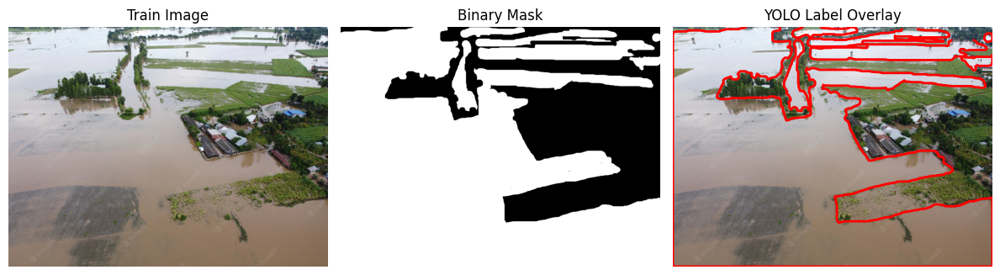

In [12]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from pathlib import Path
import random

split = "train"

base_path = Path.home() / "christina" / "dataset" / "yolo"

splits_dir = base_path / "augmented"  
aug_mask_dir = base_path / "augmented" / "masks"

img_dir   = splits_dir / split / "images"
label_dir = splits_dir / split / "labels"

# select random sample
imgs = sorted([p for p in img_dir.glob("*.jpg") if p.exists()])
idx = random.randrange(len(imgs))
img_path = imgs[idx]
label_path = label_dir / (img_path.stem + ".txt")
mask_path  = aug_mask_dir / f"{img_path.stem}.png"

#load
img = np.array(Image.open(img_path))
mask = np.array(Image.open(mask_path)) if mask_path.exists() else None

# Label-coordinates parsing
polys = []
with open(label_path) as f:
    for line in f:
        parts = line.strip().split()
        coords = list(map(float, parts[1:]))
        poly = [(coords[i] * img.shape[1], coords[i+1] * img.shape[0]) for i in range(0, len(coords), 2)]
        polys.append(poly)

# Plot
if mask is not None:
    fig, axs = plt.subplots(1, 3, figsize=(12, 4))
    axs[0].imshow(img)
    axs[0].set_title(f"{split.capitalize()} Image")
    axs[0].axis("off")

    axs[1].imshow(mask, cmap="gray")
    axs[1].set_title("Binary Mask")
    axs[1].axis("off")

    axs[2].imshow(img)
    for poly in polys:
        xs, ys = zip(*poly)
        axs[2].plot(xs, ys, '-r', linewidth=2)
    axs[2].set_title("YOLO Label Overlay")
    axs[2].axis("off")
else:
    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    axs[0].imshow(img)
    axs[0].set_title(f"{split.capitalize()} Image")
    axs[0].axis("off")

    axs[1].imshow(img)
    for poly in polys:
        xs, ys = zip(*poly)
        axs[1].plot(xs, ys, '-r', linewidth=2)
    axs[1].set_title("YOLO Label Overlay")
    axs[1].axis("off")

plt.tight_layout()
plt.show()

#### und jetzt noch die noFlood Images ergänzen:

zuerst mal für noFlood Images Data Augmentation machen:

*muss nur 1 mal gemacht werden*

In [ ]:
# delete image ...otherwise [Errno 28] No space left on device

#!rm -rf ~/christina/dataset/yolo/augmented/images/*
#!rm -rf ~/christina/dataset/yolo/augmented/masks/*
#!rm -rf ~/christina/dataset/yolo/augmented/labels/*

#%run ./utils/data_noFlood_augmentation_yolo.ipynb

#print("Dataset size before augmentation: ", len(no_flood_images))
#print("Dataset size after augmentation:", len(aug_noflood_images))

Wrote 90 label files to no_flood_images/Image/labels

--- content of a random label file no_00024.txt ---

Dataset size before augmentation:  9
Dataset size after augmentation: 90


```
Wrote 90 label files to no_flood_images/Image/labels

--- content of a random label file img_0030.txt ---

Dataset size before augmentation:  9
Dataset size after augmentation: 90
```

Train - Validation - Train split:

*muss nur 1 mal gemacht werden*

In [ ]:
from pathlib import Path

base_path = Path.home() / "christina" / "dataset" / "yolo" / "augmented"

#split_dataset(
#    image_dir=no_flood_image_dir,
#    label_dir=no_flood_label_out_dir,
#    dest_dir=base_path,
#    train_ratio=0.7,
#    val_ratio=0.15,
#    test_ratio=0.15,
#    seed=123
#)

```
Warning: No label for no_2.jpg
Warning: No label for no_5.jpg
Warning: No label for no_14.jpg
Warning: No label for no_6.jpg
Warning: No label for no_3.jpg
Warning: No label for no_8.jpg
Warning: No label for no_12.jpg
Warning: No label for no_7.jpg
Warning: No label for no_9.jpg
```

Veränderung Anzahl der Daten:

In [15]:
from pathlib import Path

base_path = Path.home() / "christina" / "dataset" / "yolo" / "augmented"

train_images = list((base_path / "train" / "images").glob("*.jpg")) + list((base_path / "train" / "images").glob("*.png"))
val_images   = list((base_path / "val" / "images").glob("*.jpg")) + list((base_path / "val" / "images").glob("*.png"))
test_images  = list((base_path / "test" / "images").glob("*.jpg")) + list((base_path / "test" / "images").glob("*.png"))

print(f"Train: {len(train_images)} images")
print(f"Val:   {len(val_images)} images")
print(f"Test:  {len(test_images)} images")

Train: 2085 images
Val:   445 images
Test:  450 images


## Model YOLOv8




In [16]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolo11n-seg.pt")  # load a pretrained model (recommended for training)

project = "YOLO - Data Augmentation"
experiment = "YOLO - Model-DataAugmentation"
batch_size = 16

config_file = "data_aug_yolo.yaml"

# Train the model
# with early stopping patience
results = model.train(data=config_file, epochs=100, project=project, name=experiment, batch=batch_size, device=0, imgsz=640, patience=30, verbose=True, val=True )

Ultralytics 8.3.158 🚀 Python-3.11.0rc1 torch-2.7.1+cu126 CUDA:0 (NVIDIA A100 80GB PCIe, 81156MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data_aug_yolo.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n-seg.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=YOLO - Model-DataAugmentation, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=30, perspective=0.0, plo

train: Scanning /mnt/nvme/home/aie3/christina/dataset/yolo/augmented/train/labels... 2085 images, 64 backgrounds, 0 corrupt: 100%|██████████| 2085/2085 [00:06<00:00, 303.36it/s]

train: New cache created: /mnt/nvme/home/aie3/christina/dataset/yolo/augmented/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 568.1±296.9 MB/s, size: 37.6 KB)


val: Scanning /mnt/nvme/home/aie3/christina/dataset/yolo/augmented/val/labels... 445 images, 12 backgrounds, 0 corrupt: 100%|██████████| 445/445 [00:00<00:00, 492.63it/s]

val: New cache created: /mnt/nvme/home/aie3/christina/dataset/yolo/augmented/val/labels.cache


Plotting labels to YOLO - Data Augmentation/YOLO - Model-DataAugmentation/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to YOLO - Data Augmentation/YOLO - Model-DataAugmentation
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      1/100      3.16G      1.362      2.939      2.021      1.385         79        640: 100%|██████████| 131/131 [00:19<00:00,  6.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  3.97it/s]

                   all        445       2088      0.505      0.364      0.378      0.207      0.484      0.352       0.34       0.15



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/100      4.15G      1.372      2.525      1.577      1.358         78        640: 100%|██████████| 131/131 [00:15<00:00,  8.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.33it/s]


                   all        445       2088      0.478      0.432      0.399      0.202      0.456      0.397      0.363      0.148

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      3/100      4.16G      1.348      2.525      1.485      1.353         53        640: 100%|██████████| 131/131 [00:15<00:00,  8.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.21it/s]


                   all        445       2088      0.489      0.438      0.404        0.2      0.474      0.412       0.37      0.148

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      4/100      4.18G      1.353      2.495      1.451      1.351         58        640: 100%|██████████| 131/131 [00:15<00:00,  8.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.42it/s]


                   all        445       2088      0.448      0.431      0.379      0.181      0.436      0.414      0.358      0.143

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      5/100       4.2G        1.3       2.42      1.368       1.32         29        640: 100%|██████████| 131/131 [00:15<00:00,  8.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.56it/s]


                   all        445       2088      0.564      0.544      0.528      0.295      0.535      0.518      0.484      0.211

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      6/100      4.21G      1.266      2.388      1.308      1.293         47        640: 100%|██████████| 131/131 [00:15<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.49it/s]


                   all        445       2088      0.598      0.463      0.501      0.307      0.601      0.454      0.482      0.238

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      7/100      4.22G      1.235      2.325       1.27      1.286         38        640: 100%|██████████| 131/131 [00:15<00:00,  8.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.44it/s]


                   all        445       2088      0.577      0.547      0.556      0.336      0.601      0.531      0.543      0.251

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      8/100      4.25G      1.205       2.26      1.223      1.255         66        640: 100%|██████████| 131/131 [00:15<00:00,  8.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.54it/s]


                   all        445       2088      0.596      0.548      0.561      0.334      0.585      0.523      0.522      0.226

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      9/100      4.27G      1.198      2.263      1.203      1.252         47        640: 100%|██████████| 131/131 [00:15<00:00,  8.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.51it/s]


                   all        445       2088      0.587      0.487      0.525      0.331      0.584      0.475      0.502      0.253

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     10/100      4.28G      1.173      2.205      1.165      1.244         56        640: 100%|██████████| 131/131 [00:16<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.58it/s]


                   all        445       2088      0.633      0.493      0.537      0.332      0.619       0.48      0.514      0.254

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     11/100      4.29G      1.169      2.208      1.156       1.24         44        640: 100%|██████████| 131/131 [00:15<00:00,  8.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.57it/s]


                   all        445       2088      0.691      0.579       0.65      0.422       0.67      0.572      0.621      0.312

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     12/100      4.31G      1.133      2.138      1.099      1.212         52        640: 100%|██████████| 131/131 [00:15<00:00,  8.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.57it/s]


                   all        445       2088       0.67      0.551      0.598      0.379      0.664      0.542      0.575      0.288

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     13/100      4.33G      1.128      2.142      1.099      1.203         48        640: 100%|██████████| 131/131 [00:15<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.59it/s]


                   all        445       2088      0.698      0.536      0.606      0.395      0.687      0.528      0.589      0.305

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     14/100      4.34G      1.103      2.097      1.064      1.191         67        640: 100%|██████████| 131/131 [00:15<00:00,  8.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.59it/s]


                   all        445       2088      0.717      0.611      0.676      0.452      0.708      0.592       0.65      0.334

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     15/100      4.35G        1.1      2.102      1.047      1.193         36        640: 100%|██████████| 131/131 [00:16<00:00,  8.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.56it/s]


                   all        445       2088      0.716      0.576      0.652      0.442      0.713      0.569      0.636      0.344

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     16/100      4.38G      1.078       2.07      1.012      1.178         36        640: 100%|██████████| 131/131 [00:16<00:00,  8.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.55it/s]


                   all        445       2088      0.768      0.602      0.705      0.489      0.765      0.599      0.694      0.375

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     17/100      4.39G      1.075      2.061      1.014      1.176         66        640: 100%|██████████| 131/131 [00:15<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088      0.734      0.627      0.705      0.487      0.727      0.622      0.692      0.374

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     18/100      4.41G      1.057      2.044      0.985      1.159         36        640: 100%|██████████| 131/131 [00:15<00:00,  8.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.62it/s]


                   all        445       2088      0.778      0.594      0.686       0.47      0.769      0.587       0.67      0.366

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     19/100      4.42G      1.046      2.016     0.9694      1.161         41        640: 100%|██████████| 131/131 [00:15<00:00,  8.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.37it/s]


                   all        445       2088      0.715       0.62      0.686      0.473      0.715      0.606      0.667      0.353

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     20/100      4.44G      1.034      1.991     0.9513      1.151         76        640: 100%|██████████| 131/131 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.51it/s]


                   all        445       2088      0.746      0.618      0.689      0.471      0.736      0.609       0.67      0.359

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     21/100      4.46G      1.029      1.988     0.9342      1.147         67        640: 100%|██████████| 131/131 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.40it/s]


                   all        445       2088       0.78      0.641      0.734      0.509      0.771      0.646      0.723      0.396

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     22/100      4.48G      1.007       1.96     0.9164      1.135         50        640: 100%|██████████| 131/131 [00:16<00:00,  8.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.50it/s]


                   all        445       2088      0.742      0.574      0.662      0.463      0.724      0.571       0.64      0.353

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     23/100      4.49G          1      1.975     0.9084      1.128         56        640: 100%|██████████| 131/131 [00:16<00:00,  8.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.61it/s]


                   all        445       2088       0.77      0.636      0.725      0.511      0.764      0.635      0.707      0.401

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     24/100      4.51G      1.006      1.926     0.8976      1.135         37        640: 100%|██████████| 131/131 [00:16<00:00,  8.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.63it/s]


                   all        445       2088      0.799      0.642      0.735      0.526      0.803      0.631      0.724      0.398

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     25/100      4.52G      1.003      1.923     0.9083      1.135         44        640: 100%|██████████| 131/131 [00:15<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.69it/s]


                   all        445       2088      0.816      0.684      0.782       0.57      0.803      0.678      0.766      0.419

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     26/100      4.54G     0.9851      1.892     0.8707      1.118         60        640: 100%|██████████| 131/131 [00:15<00:00,  8.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.57it/s]


                   all        445       2088      0.817      0.693      0.775      0.554      0.802      0.682      0.745      0.414

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     27/100      4.55G     0.9744      1.897     0.8617      1.112         38        640: 100%|██████████| 131/131 [00:15<00:00,  8.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.67it/s]


                   all        445       2088      0.801      0.671      0.757       0.55      0.798      0.665      0.742      0.414

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     28/100      4.57G     0.9606      1.864     0.8595      1.112         47        640: 100%|██████████| 131/131 [00:15<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.56it/s]


                   all        445       2088      0.801      0.671      0.758      0.553      0.789      0.661      0.741      0.421

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     29/100      4.59G     0.9376      1.836     0.8306      1.094         49        640: 100%|██████████| 131/131 [00:15<00:00,  8.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.62it/s]


                   all        445       2088      0.834      0.699      0.784      0.575      0.832      0.686      0.763      0.429

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     30/100      4.61G     0.9546      1.858     0.8397      1.098         42        640: 100%|██████████| 131/131 [00:15<00:00,  8.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.52it/s]


                   all        445       2088       0.84      0.686       0.78      0.574      0.833      0.679      0.763      0.437

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     31/100      4.61G     0.9327      1.827     0.8171      1.097         50        640: 100%|██████████| 131/131 [00:15<00:00,  8.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.58it/s]


                   all        445       2088      0.844      0.713      0.812      0.604      0.839      0.703      0.789      0.463

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     32/100      4.64G     0.9215      1.814     0.7942      1.086         42        640: 100%|██████████| 131/131 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.54it/s]


                   all        445       2088      0.812      0.709        0.8      0.592      0.833      0.682      0.781      0.448

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     33/100      4.66G     0.9277      1.821     0.7972      1.086         35        640: 100%|██████████| 131/131 [00:16<00:00,  8.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.61it/s]


                   all        445       2088      0.802       0.71      0.783      0.568      0.797        0.7      0.761      0.428

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     34/100      4.67G     0.9127       1.77      0.781      1.077         66        640: 100%|██████████| 131/131 [00:16<00:00,  8.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.51it/s]


                   all        445       2088      0.827      0.712      0.805      0.596      0.808      0.721      0.789      0.453

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     35/100      4.68G     0.9105      1.784      0.777      1.076         67        640: 100%|██████████| 131/131 [00:15<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.58it/s]


                   all        445       2088      0.845      0.735      0.821      0.615       0.84      0.723      0.799      0.472

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     36/100       4.7G     0.9128      1.769     0.7663       1.07         45        640: 100%|██████████| 131/131 [00:15<00:00,  8.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.65it/s]

                   all        445       2088      0.848      0.728      0.809      0.612      0.841       0.72      0.791      0.474



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     37/100      4.72G     0.8902      1.779     0.7594      1.068         46        640: 100%|██████████| 131/131 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.68it/s]


                   all        445       2088      0.846      0.713      0.798      0.597      0.835      0.708      0.785      0.451

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     38/100      4.74G     0.8932      1.747     0.7646      1.063         50        640: 100%|██████████| 131/131 [00:15<00:00,  8.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088      0.842      0.733      0.813      0.622      0.846      0.719      0.799      0.475

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     39/100      4.74G     0.8964      1.767     0.7552      1.071         31        640: 100%|██████████| 131/131 [00:15<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.63it/s]


                   all        445       2088      0.831      0.728      0.817      0.619      0.829      0.722      0.801      0.479

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     40/100      4.77G     0.8799      1.754     0.7475      1.064         58        640: 100%|██████████| 131/131 [00:15<00:00,  8.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.61it/s]


                   all        445       2088      0.872      0.728      0.829      0.637      0.862       0.72      0.811      0.486

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     41/100      4.79G     0.8812      1.743     0.7401       1.06         47        640: 100%|██████████| 131/131 [00:15<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.61it/s]


                   all        445       2088      0.861      0.747      0.832      0.633      0.857      0.741      0.814      0.486

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     42/100       4.8G     0.8587      1.701     0.7146      1.046         59        640: 100%|██████████| 131/131 [00:15<00:00,  8.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.51it/s]


                   all        445       2088      0.868      0.749      0.838      0.637      0.867      0.741       0.82      0.488

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     43/100      4.81G     0.8629       1.71     0.7161      1.052         36        640: 100%|██████████| 131/131 [00:15<00:00,  8.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088      0.863      0.755      0.836      0.651      0.862      0.748      0.819      0.491

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     44/100      4.84G     0.8505      1.682     0.7105      1.049         27        640: 100%|██████████| 131/131 [00:16<00:00,  8.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.66it/s]


                   all        445       2088      0.858      0.761      0.843      0.657      0.857       0.76      0.834      0.511

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     45/100      4.85G     0.8528      1.679     0.7127      1.042         76        640: 100%|██████████| 131/131 [00:16<00:00,  8.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.65it/s]


                   all        445       2088      0.864      0.743      0.821      0.641      0.862      0.741      0.807      0.496

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     46/100      4.87G       0.84      1.672     0.6928      1.039         47        640: 100%|██████████| 131/131 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.56it/s]


                   all        445       2088      0.863      0.771      0.847       0.66      0.864      0.763      0.833      0.503

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     47/100      4.88G     0.8365      1.674     0.6882      1.035         42        640: 100%|██████████| 131/131 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.56it/s]


                   all        445       2088      0.862      0.773      0.853      0.666      0.862      0.764      0.839      0.509

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     48/100       4.9G     0.8461      1.682     0.6981      1.037         64        640: 100%|██████████| 131/131 [00:16<00:00,  8.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.58it/s]


                   all        445       2088      0.885      0.767      0.861      0.676      0.876      0.759      0.844      0.508

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     49/100      4.91G     0.8236      1.644     0.6824      1.031         45        640: 100%|██████████| 131/131 [00:15<00:00,  8.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.65it/s]


                   all        445       2088      0.881      0.743      0.849      0.667        0.9      0.722      0.829       0.51

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     50/100      4.93G     0.8221      1.646      0.677      1.027         66        640: 100%|██████████| 131/131 [00:15<00:00,  8.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.60it/s]

                   all        445       2088      0.851      0.787      0.857      0.674      0.842      0.776      0.835      0.511



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     51/100      4.94G      0.821      1.632     0.6783      1.032         44        640: 100%|██████████| 131/131 [00:15<00:00,  8.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.69it/s]


                   all        445       2088      0.883      0.792      0.864      0.689      0.878      0.785      0.848      0.518

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     52/100      4.97G     0.8184      1.628     0.6667      1.024         28        640: 100%|██████████| 131/131 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]

                   all        445       2088       0.88      0.784      0.864      0.685      0.875       0.78      0.847      0.517



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     53/100      4.98G     0.8042      1.616     0.6577      1.029         36        640: 100%|██████████| 131/131 [00:15<00:00,  8.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.63it/s]


                   all        445       2088       0.89      0.776      0.864      0.687      0.886      0.763      0.847      0.525

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     54/100         5G     0.8133      1.631     0.6596      1.023         28        640: 100%|██████████| 131/131 [00:16<00:00,  8.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.65it/s]

                   all        445       2088      0.908      0.783      0.872      0.696      0.896      0.781      0.862      0.533



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     55/100         5G     0.8049      1.621     0.6588      1.025         57        640: 100%|██████████| 131/131 [00:15<00:00,  8.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.69it/s]

                   all        445       2088      0.887      0.784      0.869      0.696      0.882      0.778      0.852       0.53



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     56/100      5.03G     0.8058      1.621     0.6616      1.026         35        640: 100%|██████████| 131/131 [00:15<00:00,  8.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.65it/s]


                   all        445       2088      0.887      0.783      0.872      0.699      0.882      0.779      0.854      0.533

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     57/100      5.05G     0.7967      1.575     0.6505      1.022         41        640: 100%|██████████| 131/131 [00:15<00:00,  8.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]


                   all        445       2088      0.895      0.779      0.873      0.694       0.89      0.777      0.855       0.54

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     58/100      5.06G     0.7766      1.562     0.6359      1.013         37        640: 100%|██████████| 131/131 [00:15<00:00,  8.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.76it/s]


                   all        445       2088      0.895      0.797       0.88      0.707      0.888       0.79      0.862      0.538

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     59/100      5.07G     0.7866      1.577     0.6418      1.012         43        640: 100%|██████████| 131/131 [00:15<00:00,  8.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.70it/s]

                   all        445       2088       0.87      0.823      0.882      0.712      0.877      0.798      0.864      0.543



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     60/100      5.09G     0.7853      1.565     0.6281      1.008         49        640: 100%|██████████| 131/131 [00:15<00:00,  8.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.62it/s]


                   all        445       2088      0.878      0.813      0.882      0.709      0.878      0.805      0.867      0.543

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     61/100      5.11G     0.7754      1.555     0.6147      1.011         47        640: 100%|██████████| 131/131 [00:15<00:00,  8.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.73it/s]


                   all        445       2088      0.892      0.802      0.878      0.708        0.9      0.784      0.862       0.54

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     62/100      5.12G     0.7713      1.563     0.6239      1.002         59        640: 100%|██████████| 131/131 [00:15<00:00,  8.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]

                   all        445       2088       0.88      0.807      0.879      0.707      0.875      0.796       0.86      0.543



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     63/100      5.13G     0.7542      1.534     0.6192      1.003         75        640: 100%|██████████| 131/131 [00:15<00:00,  8.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.75it/s]

                   all        445       2088      0.895      0.806       0.88      0.713       0.89      0.801      0.865      0.551



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     64/100      5.16G     0.7732      1.547     0.6228      1.006         53        640: 100%|██████████| 131/131 [00:16<00:00,  8.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.56it/s]


                   all        445       2088      0.883       0.82      0.885      0.719      0.876      0.812      0.871      0.551

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     65/100      5.18G     0.7652      1.541     0.6106      1.007         40        640: 100%|██████████| 131/131 [00:15<00:00,  8.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.62it/s]


                   all        445       2088      0.896      0.807      0.879       0.72      0.891      0.802      0.865      0.554

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     66/100      5.19G     0.7551      1.531     0.6088      1.002        117        640: 100%|██████████| 131/131 [00:15<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.57it/s]


                   all        445       2088       0.89      0.803      0.877      0.712      0.885      0.798      0.863      0.548

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     67/100       5.2G     0.7506      1.505     0.5936      0.992         65        640: 100%|██████████| 131/131 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.56it/s]


                   all        445       2088      0.899      0.808      0.883      0.724      0.894      0.801      0.864      0.557

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     68/100      5.22G     0.7424      1.513     0.5975     0.9931         58        640: 100%|██████████| 131/131 [00:15<00:00,  8.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.70it/s]

                   all        445       2088      0.899      0.819      0.886      0.726      0.896        0.8      0.866      0.556



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     69/100      5.24G     0.7427      1.503     0.5892     0.9928         43        640: 100%|██████████| 131/131 [00:15<00:00,  8.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.67it/s]

                   all        445       2088      0.888      0.823      0.886      0.729      0.907      0.798       0.87      0.563



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     70/100      5.26G     0.7456      1.523     0.5922     0.9901         48        640: 100%|██████████| 131/131 [00:15<00:00,  8.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.69it/s]

                   all        445       2088      0.911      0.815      0.892       0.73      0.902      0.807      0.874       0.56



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     71/100      5.26G     0.7374      1.491     0.5864     0.9912         48        640: 100%|██████████| 131/131 [00:15<00:00,  8.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.66it/s]

                   all        445       2088      0.899      0.823      0.889       0.73      0.893      0.814      0.874      0.563



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     72/100      5.29G     0.7315      1.485     0.5813     0.9874         41        640: 100%|██████████| 131/131 [00:15<00:00,  8.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.58it/s]

                   all        445       2088      0.901       0.82      0.893      0.732      0.895      0.815      0.874      0.565



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     73/100       5.3G     0.7225      1.479     0.5697     0.9848         44        640: 100%|██████████| 131/131 [00:15<00:00,  8.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.68it/s]

                   all        445       2088      0.894       0.81      0.884       0.73      0.891      0.806      0.872      0.565



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     74/100      5.32G     0.7252      1.494      0.577     0.9891         68        640: 100%|██████████| 131/131 [00:15<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.74it/s]

                   all        445       2088      0.897      0.821      0.893      0.733      0.888      0.811      0.874      0.561



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     75/100      5.33G     0.7177      1.464     0.5641     0.9842         47        640: 100%|██████████| 131/131 [00:16<00:00,  8.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.61it/s]

                   all        445       2088      0.907      0.818      0.888      0.735      0.904      0.807       0.87      0.566



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     76/100      5.36G     0.7231      1.508     0.5755     0.9877         41        640: 100%|██████████| 131/131 [00:16<00:00,  8.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.75it/s]

                   all        445       2088      0.921       0.81      0.893      0.739      0.912      0.804      0.876       0.57



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     77/100      5.37G     0.7126      1.474     0.5603       0.98         43        640: 100%|██████████| 131/131 [00:15<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.54it/s]

                   all        445       2088      0.901      0.828      0.893      0.741      0.905      0.819      0.879      0.572



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     78/100      5.39G     0.7074      1.462     0.5622      0.978         38        640: 100%|██████████| 131/131 [00:15<00:00,  8.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.70it/s]

                   all        445       2088       0.91      0.822      0.897      0.743      0.913      0.809       0.88      0.572



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     79/100      5.39G     0.6986      1.445     0.5509     0.9736         65        640: 100%|██████████| 131/131 [00:15<00:00,  8.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.69it/s]

                   all        445       2088      0.905      0.837      0.898      0.743      0.904      0.819      0.881      0.581



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     80/100      5.42G     0.6962      1.426     0.5499     0.9718         50        640: 100%|██████████| 131/131 [00:16<00:00,  8.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.67it/s]


                   all        445       2088      0.914      0.811      0.893      0.742      0.912      0.802      0.875      0.569

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     81/100      5.44G      0.704      1.445     0.5568     0.9766         39        640: 100%|██████████| 131/131 [00:15<00:00,  8.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.75it/s]

                   all        445       2088      0.904      0.827      0.898      0.747      0.913       0.81      0.878      0.574



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     82/100      5.45G      0.688      1.419     0.5493     0.9739         58        640: 100%|██████████| 131/131 [00:15<00:00,  8.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.66it/s]

                   all        445       2088      0.905      0.815      0.891      0.744        0.9       0.81      0.875      0.574



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     83/100      5.46G     0.6886      1.421     0.5424     0.9704         47        640: 100%|██████████| 131/131 [00:15<00:00,  8.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.63it/s]

                   all        445       2088       0.92      0.818      0.896       0.75      0.913      0.808      0.878      0.579



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     84/100      5.48G     0.6852       1.42     0.5342     0.9676         40        640: 100%|██████████| 131/131 [00:15<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.64it/s]

                   all        445       2088      0.893      0.834      0.898       0.75      0.895      0.813      0.878       0.58



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     85/100       5.5G      0.697      1.429     0.5454     0.9728         67        640: 100%|██████████| 131/131 [00:15<00:00,  8.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.62it/s]

                   all        445       2088      0.911      0.831      0.899      0.754      0.906      0.818      0.879      0.587



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     86/100      5.52G     0.6786      1.408     0.5309     0.9655         65        640: 100%|██████████| 131/131 [00:15<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.60it/s]

                   all        445       2088      0.905      0.838      0.901      0.757      0.898       0.83      0.886      0.586



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     87/100      5.52G      0.682      1.405     0.5389     0.9673         58        640: 100%|██████████| 131/131 [00:16<00:00,  8.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.68it/s]

                   all        445       2088      0.884       0.85      0.898      0.754        0.9      0.827      0.885      0.589



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     88/100      5.55G     0.6799      1.412     0.5277     0.9683         30        640: 100%|██████████| 131/131 [00:16<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.59it/s]

                   all        445       2088      0.902       0.84      0.903      0.757      0.895      0.832      0.887      0.585



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     89/100      5.56G     0.6749      1.399     0.5292     0.9653         67        640: 100%|██████████| 131/131 [00:15<00:00,  8.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.67it/s]

                   all        445       2088      0.898      0.839      0.899      0.758      0.907       0.82      0.885      0.583



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     90/100      5.58G     0.6749      1.395     0.5325     0.9672         63        640: 100%|██████████| 131/131 [00:16<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.58it/s]

                   all        445       2088      0.914      0.838      0.901      0.758      0.908      0.831      0.887      0.585


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     91/100      5.59G     0.6645      1.392     0.5243     0.9704         40        640: 100%|██████████| 131/131 [00:16<00:00,  7.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.58it/s]

                   all        445       2088      0.905      0.839      0.898      0.751      0.908      0.826      0.883      0.579



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     92/100      5.62G     0.6352      1.341     0.4799     0.9483         39        640: 100%|██████████| 131/131 [00:15<00:00,  8.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.67it/s]

                   all        445       2088      0.918      0.836        0.9      0.756      0.915      0.824      0.886      0.583



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     93/100      5.63G     0.6222      1.333     0.4686     0.9427         32        640: 100%|██████████| 131/131 [00:15<00:00,  8.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.60it/s]

                   all        445       2088      0.906      0.844      0.902      0.759      0.899      0.838      0.887      0.584



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     94/100      5.65G     0.6108      1.315     0.4575     0.9375         13        640: 100%|██████████| 131/131 [00:15<00:00,  8.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.58it/s]


                   all        445       2088      0.899      0.854      0.904      0.764      0.894      0.843      0.888       0.59

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     95/100      5.66G     0.6082      1.306     0.4545     0.9349         22        640: 100%|██████████| 131/131 [00:15<00:00,  8.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.63it/s]

                   all        445       2088      0.903      0.853      0.907      0.766      0.901      0.841      0.891      0.588



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     96/100      5.68G     0.5999      1.302     0.4516     0.9334         34        640: 100%|██████████| 131/131 [00:15<00:00,  8.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.71it/s]

                   all        445       2088      0.907       0.85      0.904      0.768      0.907      0.834      0.889      0.594



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     97/100       5.7G      0.597       1.29     0.4484     0.9345         15        640: 100%|██████████| 131/131 [00:15<00:00,  8.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.67it/s]

                   all        445       2088      0.907      0.848      0.906      0.769      0.897      0.846      0.891      0.593



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     98/100      5.71G      0.587      1.286     0.4461     0.9235         15        640: 100%|██████████| 131/131 [00:15<00:00,  8.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.68it/s]

                   all        445       2088      0.909       0.85      0.906      0.773      0.901      0.841      0.893      0.596



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     99/100      5.72G     0.5894      1.279     0.4445     0.9295         28        640: 100%|██████████| 131/131 [00:15<00:00,  8.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.75it/s]

                   all        445       2088      0.912      0.846      0.905      0.771      0.907      0.837      0.891      0.596



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    100/100      5.75G     0.5812      1.271     0.4377     0.9272         26        640: 100%|██████████| 131/131 [00:15<00:00,  8.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.62it/s]

                   all        445       2088      0.915      0.846      0.905      0.772      0.907      0.836      0.892      0.595



100 epochs completed in 0.520 hours.
Optimizer stripped from YOLO - Data Augmentation/YOLO - Model-DataAugmentation/weights/last.pt, 6.0MB
Optimizer stripped from YOLO - Data Augmentation/YOLO - Model-DataAugmentation/weights/best.pt, 6.0MB

Validating YOLO - Data Augmentation/YOLO - Model-DataAugmentation/weights/best.pt...
Ultralytics 8.3.158 🚀 Python-3.11.0rc1 torch-2.7.1+cu126 CUDA:0 (NVIDIA A100 80GB PCIe, 81156MiB)
YOLO11n-seg summary (fused): 113 layers, 2,834,763 parameters, 0 gradients, 10.2 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   0%|          | 0/14 [00:00<?, ?it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   7%|▋         | 1/14 [00:00<00:02,  5.52it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):  14%|█▍        | 2/14 [00:00<00:03,  3.06it/s]

WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:03<00:00,  4.51it/s]


                   all        445       2088      0.909       0.85      0.906      0.772        0.9      0.841      0.892      0.596
Speed: 0.1ms preprocess, 0.5ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to YOLO - Data Augmentation/YOLO - Model-DataAugmentation


Resluts are stored in Folder YOLO - Data Augmentation



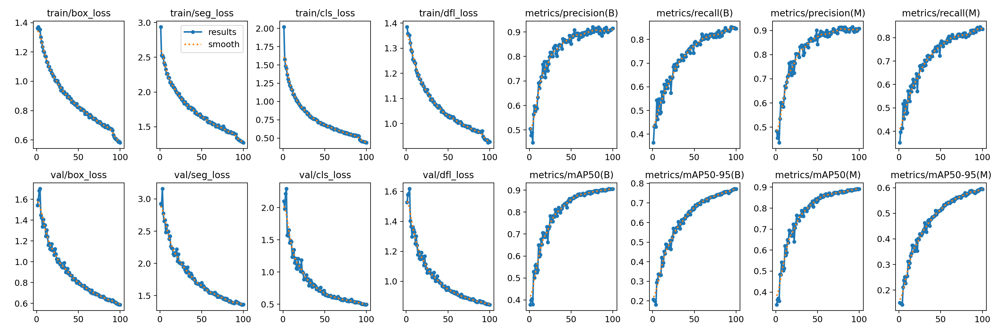

In [17]:
image_path = "YOLO - Data Augmentation/YOLO - Model-DataAugmentation/results.png"

from IPython.display import Image
Image(filename=image_path)

##### Confusion Matrix normalisiert:

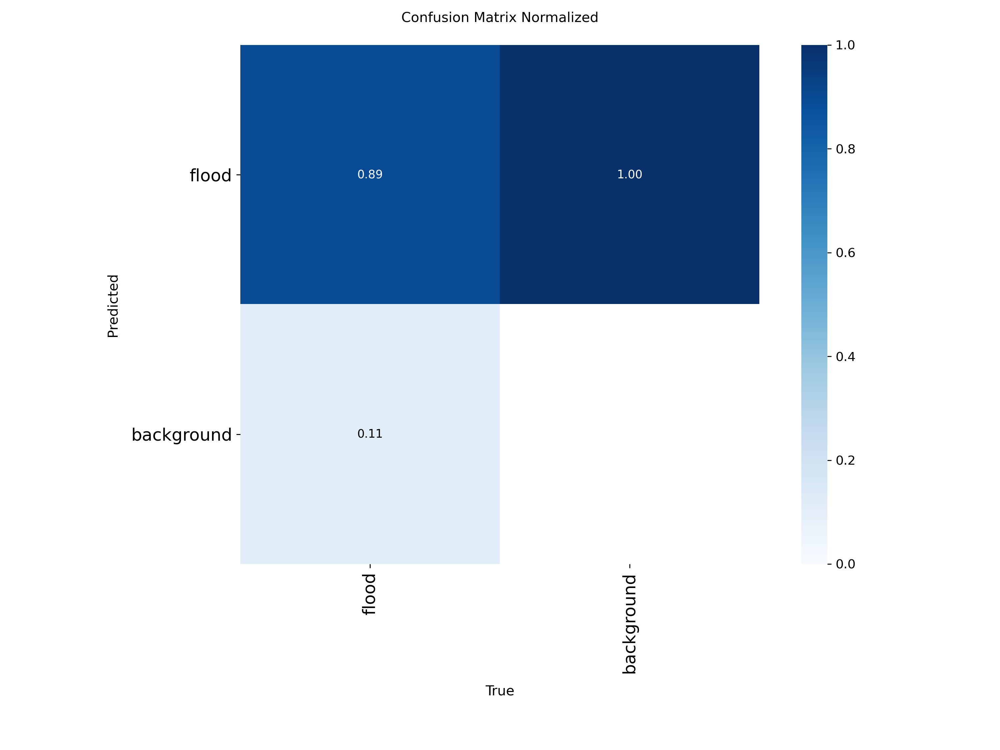

In [18]:
image_path = "YOLO - Data Augmentation/YOLO - Model-DataAugmentation/confusion_matrix_normalized.png"

from IPython.display import Image
Image(filename=image_path)

In [19]:
model.info()

YOLO11n-seg summary: 203 layers, 2,842,803 parameters, 0 gradients, 10.4 GFLOPs


(203, 2842803, 0, 10.355763199999998)

In [20]:
results

ultralytics.utils.metrics.SegmentMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7fad7c92fc50>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(M)', 'F1-Confidence(M)', 'Precision-Confidence(M)', 'Recall-Confidence(M)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041, 

### Modell-Architektur

In [21]:
from torchinfo import summary
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.model.to(device)

summary(model.model, input_size=(1, 3, 640, 640), col_names=["input_size", "output_size", "num_params", "trainable"])

Layer (type:depth-idx)                                       Input Shape               Output Shape              Param #                   Trainable
SegmentationModel                                            [1, 3, 640, 640]          [1, 37, 8400]             --                        False
├─Sequential: 1-1                                            --                        --                        --                        False
│    └─Conv: 2-1                                             [1, 3, 640, 640]          [1, 16, 320, 320]         --                        False
│    │    └─Conv2d: 3-1                                      [1, 3, 640, 640]          [1, 16, 320, 320]         (432)                     False
│    │    └─BatchNorm2d: 3-2                                 [1, 16, 320, 320]         [1, 16, 320, 320]         (32)                      False
│    └─Segment: 2-124                                        --                        --                        (recursive)  

### Train und Validation batches anzeigen

Train batches shown: 6
Val batches shown:   6


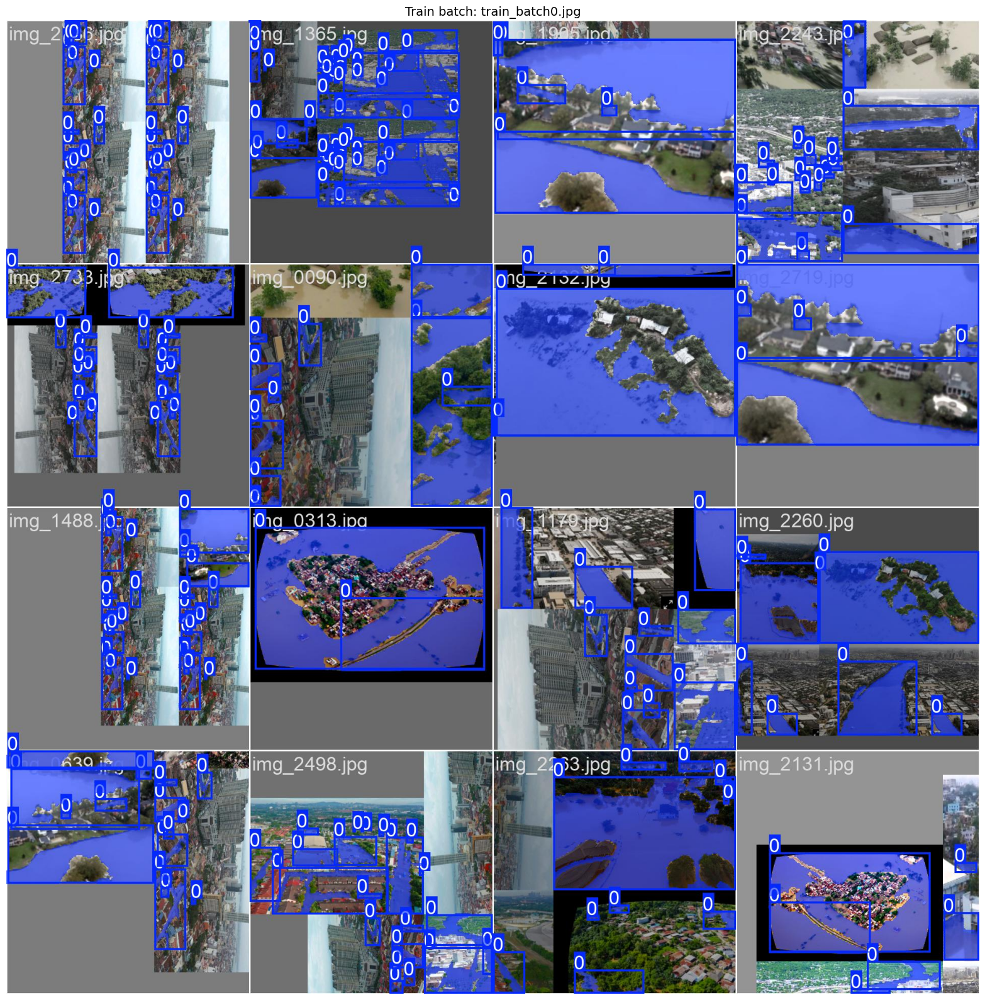

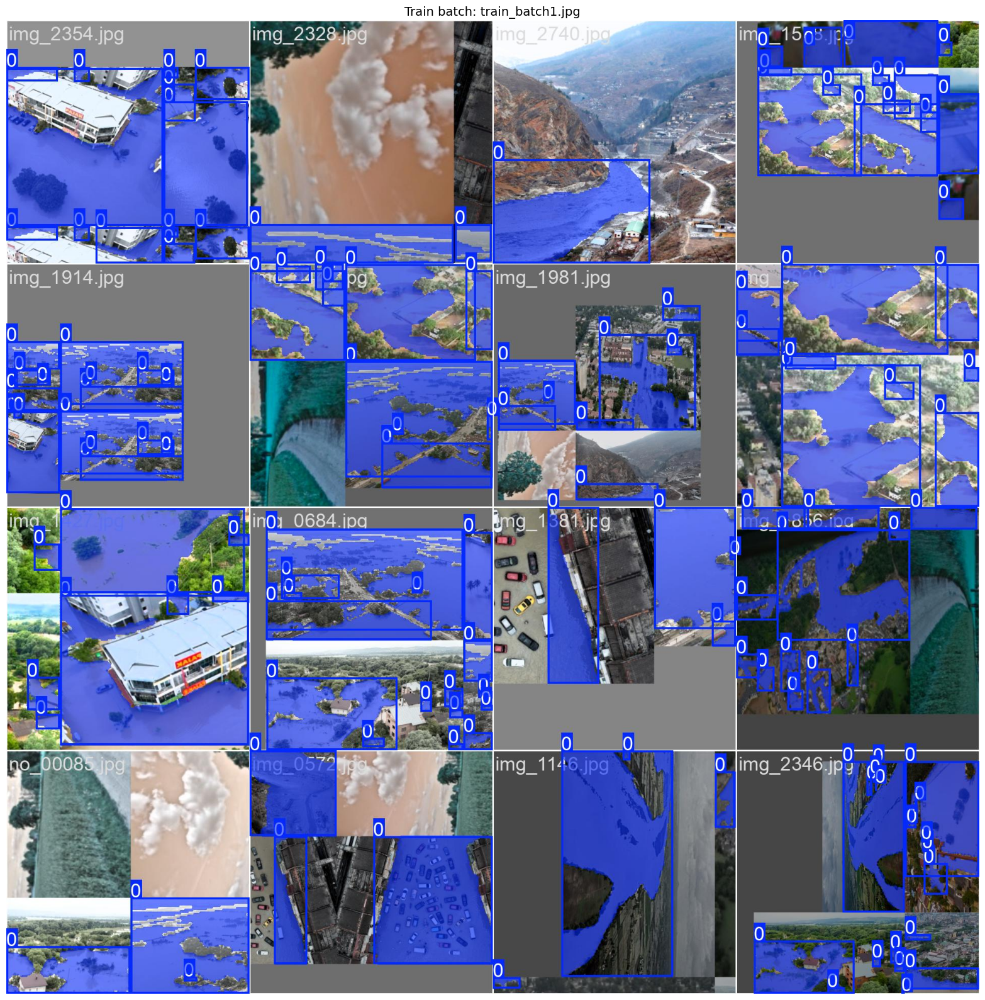

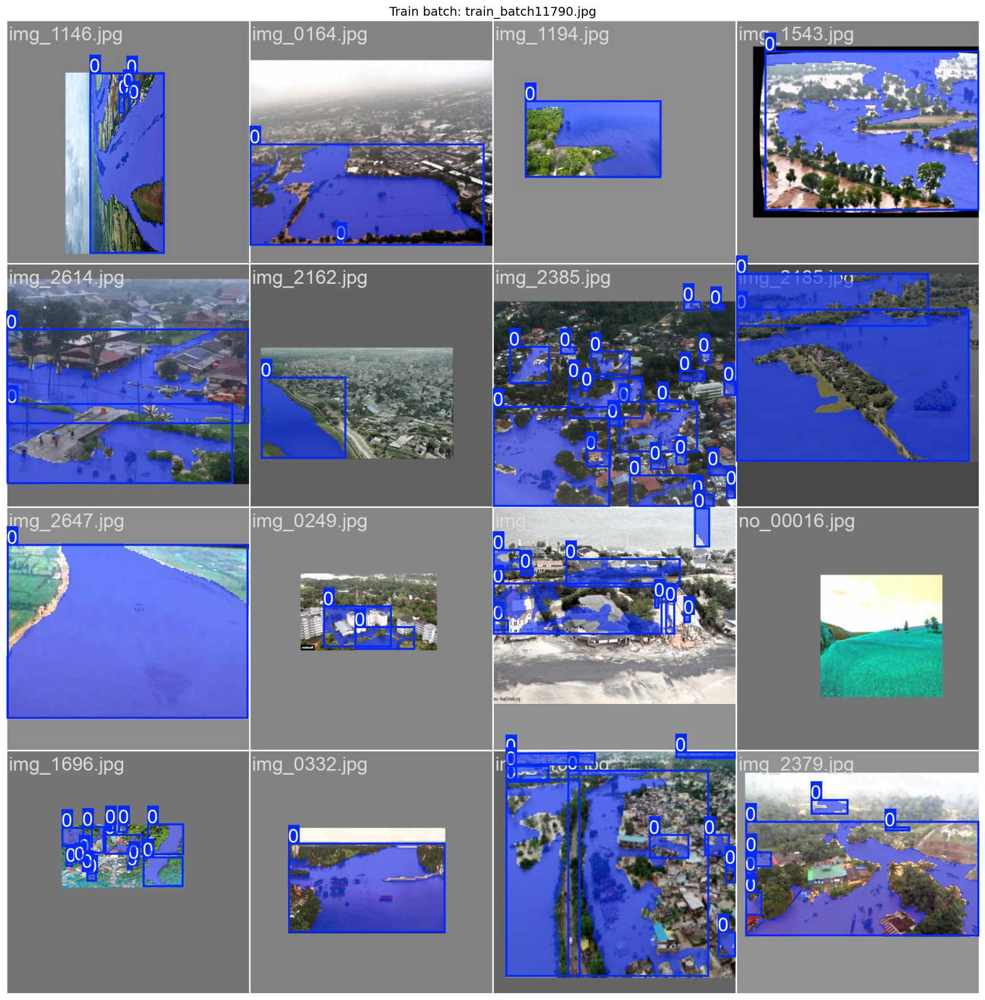

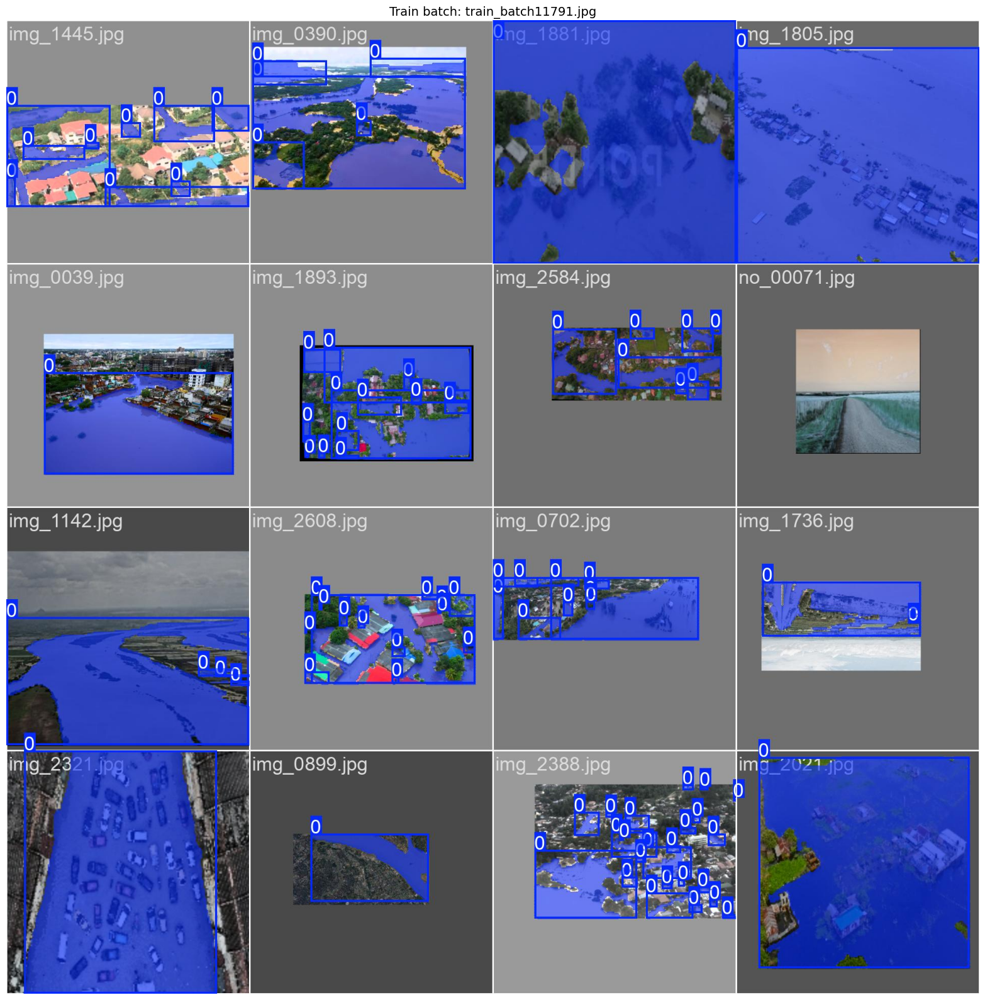

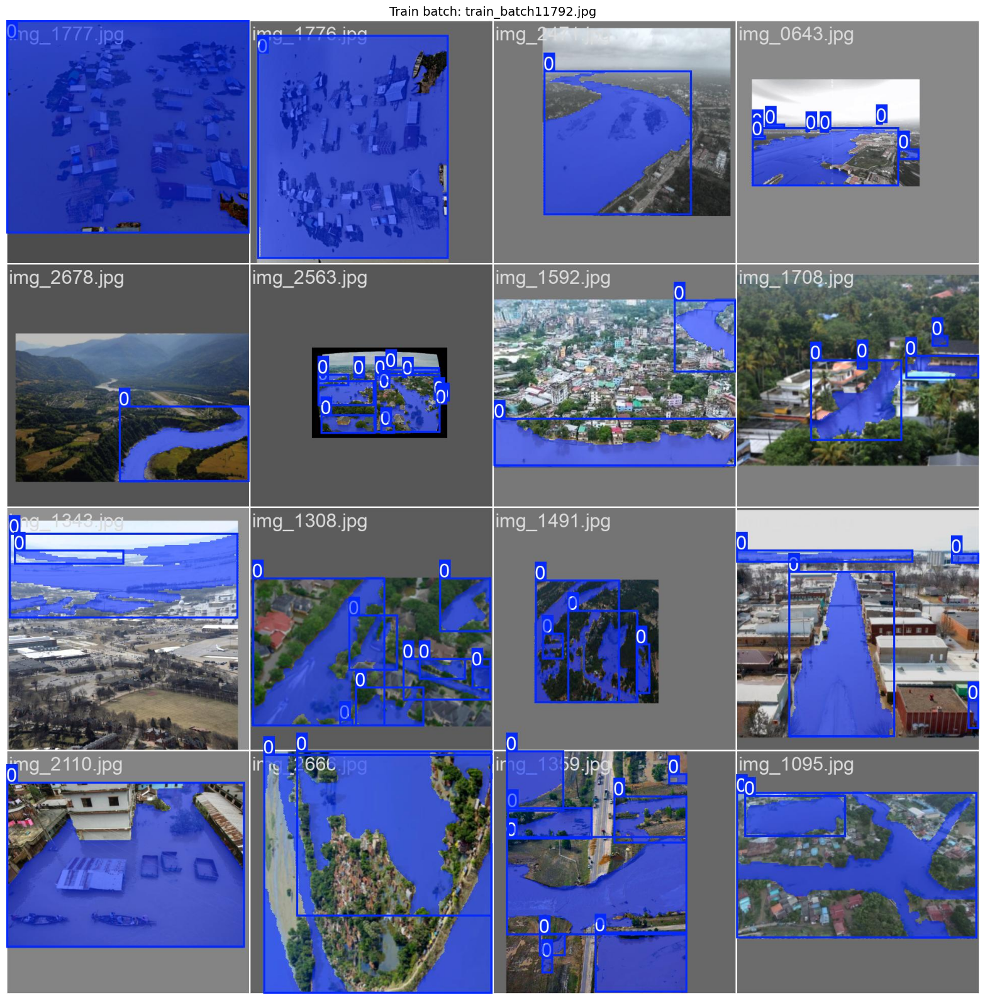

...

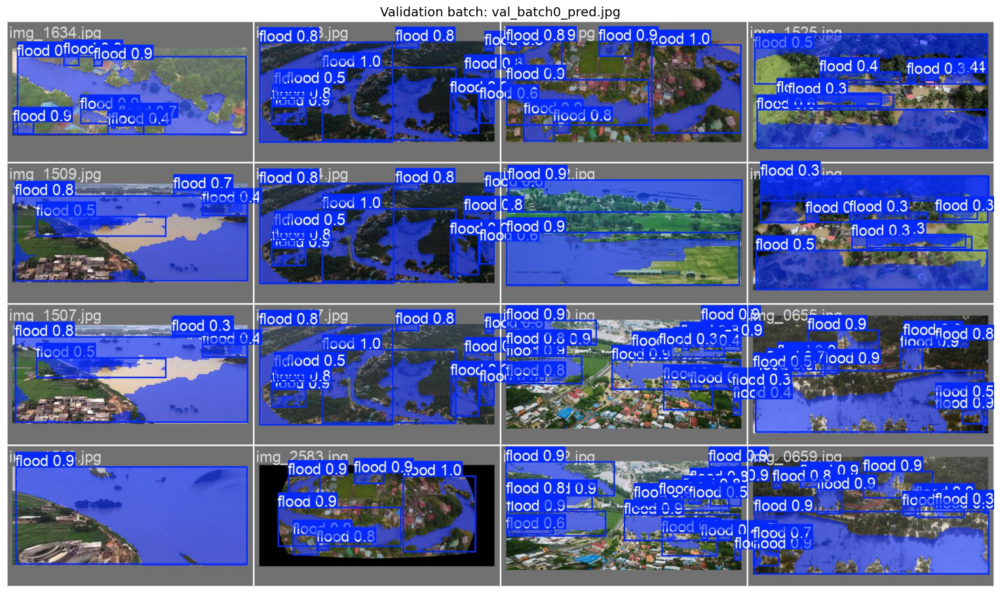

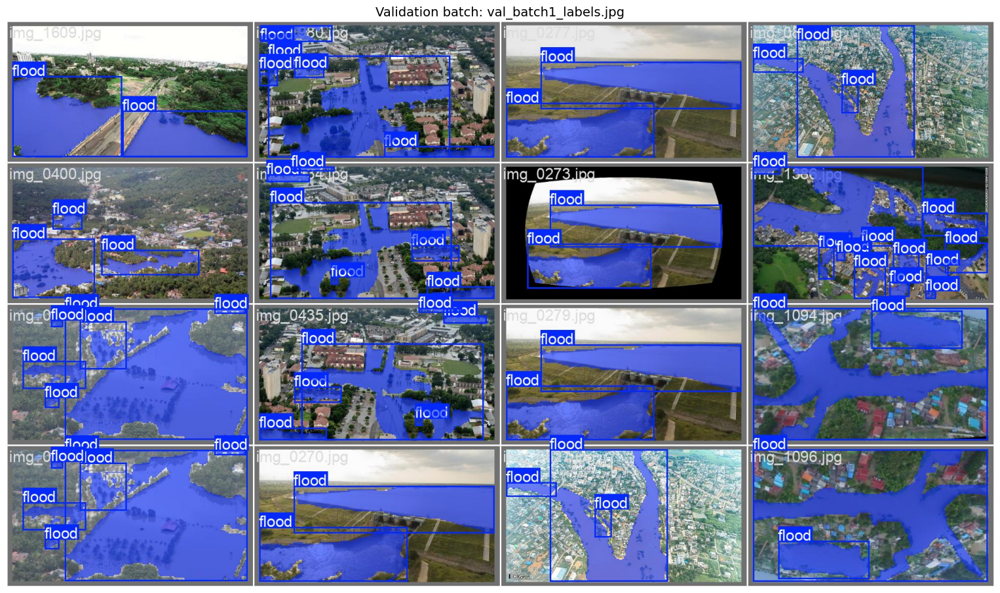

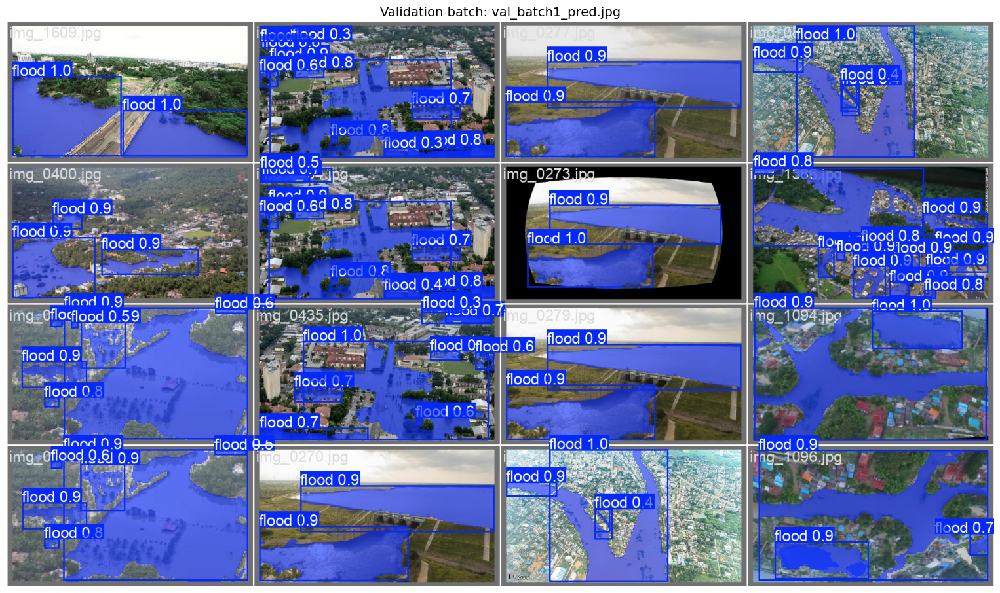

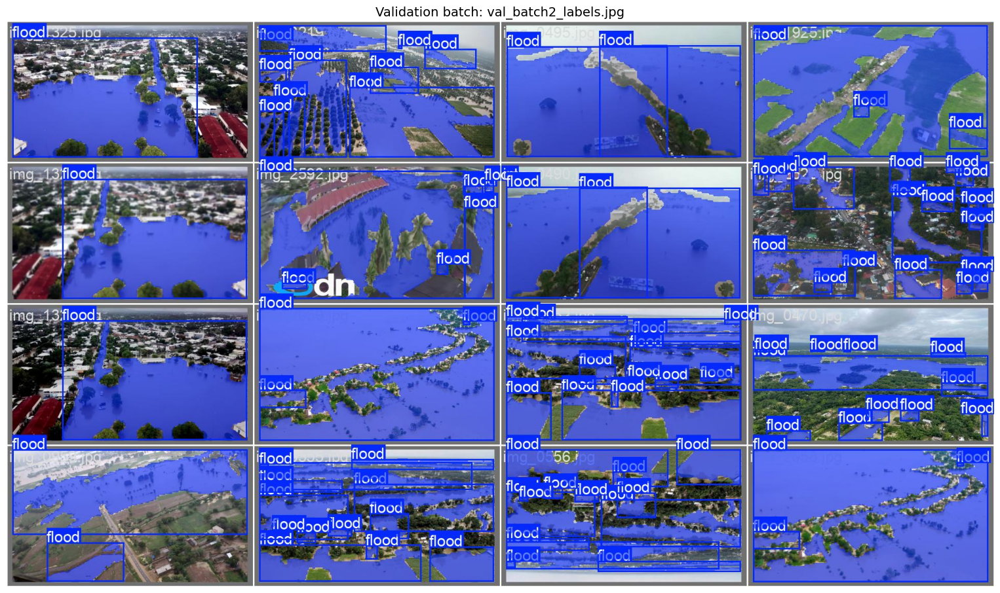

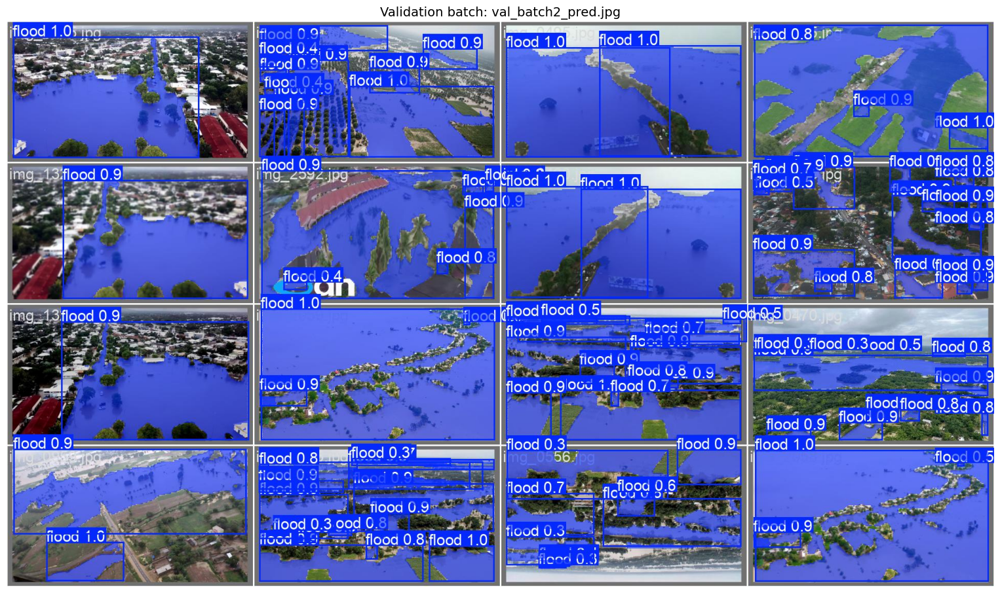

In [22]:
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image

batch_dir = Path("YOLO - Data Augmentation/YOLO - Model-DataAugmentation")

train_imgs = sorted(batch_dir.glob("train_batch*.jpg"))
val_imgs = sorted(batch_dir.glob("val_batch*.jpg"))

train_imgs = train_imgs[:6]
val_imgs = val_imgs[:6]

print(f"Train batches shown: {len(train_imgs)}")
print(f"Val batches shown:   {len(val_imgs)}")

def show_images(image_paths, title_prefix):
    for img_path in image_paths:
        img = Image.open(img_path)

        width, height = img.size
        aspect_ratio = height / width

        fig_width = 16
        fig_height = fig_width * aspect_ratio

        plt.figure(figsize=(fig_width, fig_height))
        plt.imshow(img)
        plt.title(f"{title_prefix}: {img_path.name}", fontsize=14)
        plt.axis('off')
        plt.tight_layout()
        plt.show()

show_images(train_imgs, "Train batch")
show_images(val_imgs, "Validation batch")

##### Mit Testdaten 


0: 640x640 1 flood, 7.6ms
Speed: 1.8ms preprocess, 7.6ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 640)


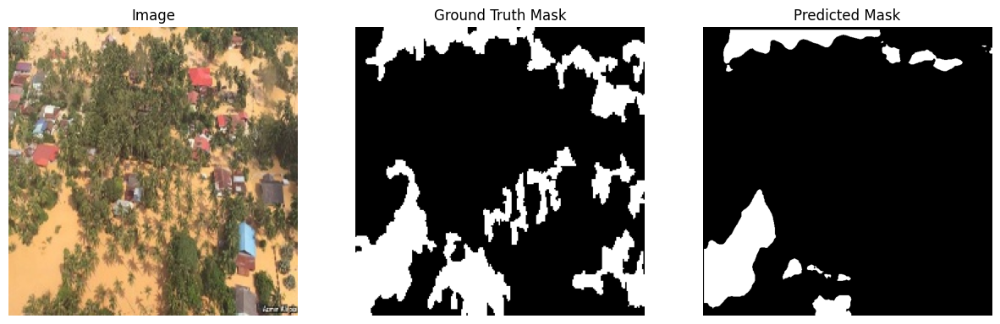


0: 448x640 3 floods, 59.5ms
Speed: 1.9ms preprocess, 59.5ms inference, 1.9ms postprocess per image at shape (1, 3, 448, 640)


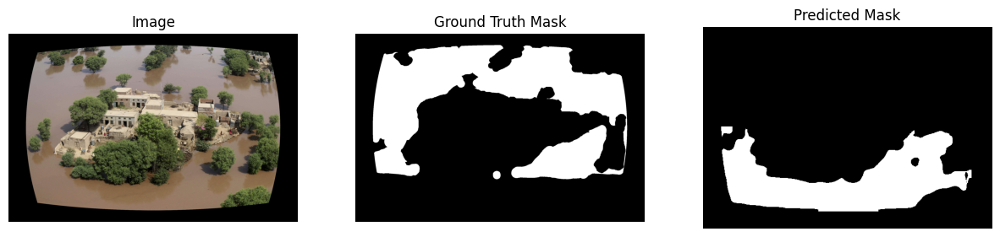


0: 480x640 1 flood, 58.9ms
Speed: 1.9ms preprocess, 58.9ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


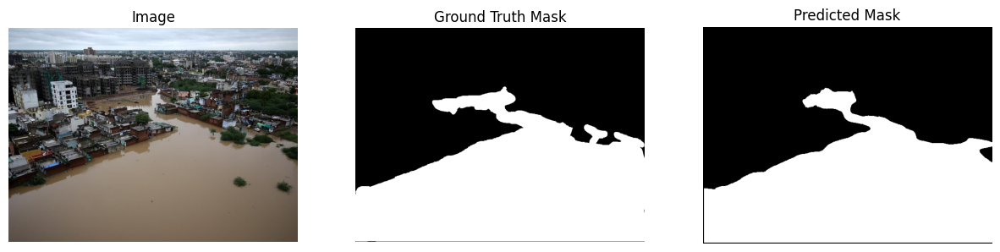


0: 384x640 3 floods, 58.8ms
Speed: 1.5ms preprocess, 58.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


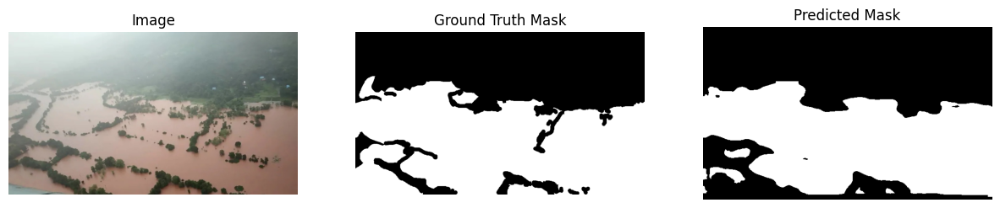


0: 384x640 3 floods, 8.7ms
Speed: 1.5ms preprocess, 8.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


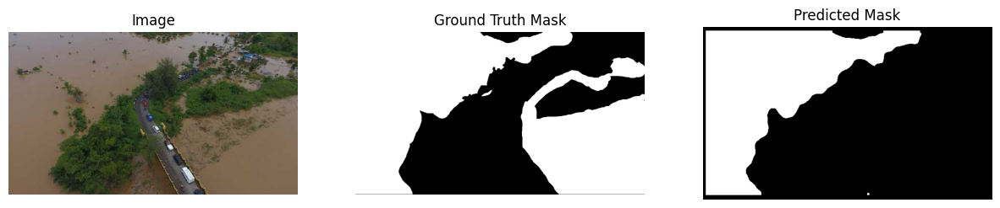

In [23]:
from pathlib import Path
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

base_path = Path.home() / "christina" / "dataset" / "yolo" / "augmented"
test_img_dir = base_path / "test" / "images"
test_label_dir = base_path / "test" / "labels"

test_images = sorted(test_img_dir.glob("*.png")) + sorted(test_img_dir.glob("*.jpg"))

# loading the ground truth mask from label file (YOLO polygon format)
def load_gt_mask(label_path, img_size):
    mask = np.zeros(img_size, dtype=np.uint8)
    if not label_path.exists():
        return mask
    with open(label_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            coords = list(map(float, parts[1:]))
            # Coordinates normalized, convert to pixels
            poly = [(int(x * img_size[1]), int(y * img_size[0])) for x, y in zip(coords[0::2], coords[1::2])]
            # Fill polygon (OpenCV required)
            import cv2
            pts = np.array(poly, dtype=np.int32)
            cv2.fillPoly(mask, [pts], 255)
    return mask

def visualize_test_predictions(model, test_images, test_label_dir, num_images=5):
    for img_path in test_images[:num_images]:
        try:
            img = np.array(Image.open(img_path).convert("RGB"))
        except Exception as e:
            print(f"Skipping {img_path.name}: {e}")
            continue
        label_path = test_label_dir / (img_path.stem + ".txt")
        gt_mask = load_gt_mask(label_path, img.shape[:2])

        # predict with YOLO
        result = model.predict(img)[0]
        # extract first mask
        pred_mask = result.masks.data.cpu().numpy()[0]

        plt.figure(figsize=(15,5))

        plt.subplot(1,3,1)
        plt.title("Image")
        plt.imshow(img)
        plt.axis("off")

        plt.subplot(1,3,2)
        plt.title("Ground Truth Mask")
        plt.imshow(gt_mask, cmap="gray")
        plt.axis("off")

        plt.subplot(1,3,3)
        plt.title("Predicted Mask")
        plt.imshow(pred_mask, cmap="gray")
        plt.axis("off")

        plt.show()


visualize_test_predictions(model, test_images, test_label_dir, num_images=5)

#### Evaluierung mit Testdaten

Zu beachten ist jedoch:
- Verwendung von `model.predict()` auf den Testbildern, um die vom YOLOv8-Modell vorhergesagten Segmentierungs-Masken zu erhalten.
- Da YOLO mehrere Masken pro Bild zurückgeben kann, werden diese zu einer einzigen Maske pro Bild ( per Pixel-Maximum) kombiniert.
- Die vorhergesagten Masken und Ground-Truth-Masken werden binarisiert (Threshold 0.5) und in flache Arrays umgeformt, um sie mit sklearn-Metriken auswerten zu können.
- Precision, Recall, F1-Score und Intersection-over-Union (IoU) werden für jede Maske einzeln berechnet und danach der Mittelwert über alle Testbilder ermittlet.


Testdaten vorbereiten

In [24]:
from pathlib import Path
from PIL import Image
import numpy as np
import cv2

desired_size = (640, 640)

base_path = Path.home() / "christina" / "dataset" / "yolo" / "augmented"
test_images_dir = base_path / "test" / "images"
test_labels_dir = base_path / "test" / "labels"

test_image_paths = sorted(list(test_images_dir.glob("*.jpg")))

X_test = [np.array(Image.open(p)) for p in test_image_paths]

def label_to_mask(label_path, img_shape, desired_size=(640, 640)):
    import cv2
    mask = np.zeros(img_shape[:2], dtype=np.uint8)
    with open(label_path) as f:
        for line in f:
            parts = line.strip().split()
            coords = list(map(float, parts[1:]))
            pts = np.array([[int(x * img_shape[1]), int(y * img_shape[0])] for x, y in zip(coords[::2], coords[1::2])])
            cv2.fillPoly(mask, [pts], 255)
    mask_resized = cv2.resize(mask, desired_size, interpolation=cv2.INTER_NEAREST)
    return mask_resized

y_test = []
for img_path in test_image_paths:
    label_path = test_labels_dir / f"{img_path.stem}.txt"
    img_shape = np.array(Image.open(img_path)).shape
    mask = label_to_mask(label_path, img_shape, desired_size=desired_size) if label_path.exists() else np.zeros(desired_size, dtype=np.uint8)
    y_test.append(mask)

y_test = np.array(y_test)

In [31]:
import numpy as np
from sklearn.metrics import precision_score, recall_score, f1_score, jaccard_score
from PIL import Image


def extract_masks(results, image_shape=(640, 640)):
    masks = []
    for r in results:
        if r.masks is None:
            masks.append(np.zeros(image_shape, dtype=np.uint8))
        else:
            # result.masks.data shape: [num_masks, H, W]
            mask = r.masks.data.cpu().numpy()
            #  If several masks use only the first mask. Or combine all masks into one (max per pixel)
            combined_mask = np.max(mask, axis=0) if mask.shape[0] > 1 else mask[0]
            masks.append(combined_mask)
    return np.array(masks)

# Example: X_test is list/array of images, y_test is GT masks as np.array
results = model.predict(source=[str(p) for p in test_image_paths])

y_pred_masks = extract_masks(results, image_shape=(640, 640))

# Binarization with Threshold 0.5
y_pred_binary = (y_pred_masks > 0.5).astype(int)
y_true_binary = (y_test > 0.5).astype(int)

# flatten for sklearn metrics
y_true_flat = y_true_binary.reshape(y_true_binary.shape[0], -1)
y_pred_flat = y_pred_binary.reshape(y_pred_binary.shape[0], -1)

# Calculate metrics per image and calculate average value
precisions = []
recalls = []
f1s = []
ious = []

for yt, yp in zip(y_true_flat, y_pred_flat):
    if yt.sum() == 0 and yp.sum() == 0:
        # Perfekter Fall: kein GT, kein Prediction
        precisions.append(1.0)
        recalls.append(1.0)
        f1s.append(1.0)
        ious.append(1.0)
    else:
        precisions.append(precision_score(yt, yp, zero_division=0))
        recalls.append(recall_score(yt, yp, zero_division=0))
        f1s.append(f1_score(yt, yp, zero_division=0))
        ious.append(jaccard_score(yt, yp, zero_division=0))

print("\n===== Final Test Evaluation =====")
print(f"Precision: {np.mean(precisions):.4f}")
print(f"Recall:    {np.mean(recalls):.4f}")
print(f"F1 Score:  {np.mean(f1s):.4f}")
print(f"IoU:       {np.mean(ious):.4f}")


0: 640x640 16 floods, 0.6ms
1: 640x640 2 floods, 0.6ms
2: 640x640 1 flood, 0.6ms
3: 640x640 4 floods, 0.6ms
4: 640x640 2 floods, 0.6ms
5: 640x640 2 floods, 0.6ms
6: 640x640 4 floods, 0.6ms
7: 640x640 4 floods, 0.6ms
8: 640x640 3 floods, 0.6ms
9: 640x640 3 floods, 0.6ms
10: 640x640 3 floods, 0.6ms
11: 640x640 6 floods, 0.6ms
12: 640x640 2 floods, 0.6ms
13: 640x640 7 floods, 0.6ms
14: 640x640 3 floods, 0.6ms
15: 640x640 3 floods, 0.6ms
16: 640x640 1 flood, 0.6ms
17: 640x640 7 floods, 0.6ms
18: 640x640 1 flood, 0.6ms
19: 640x640 1 flood, 0.6ms
20: 640x640 2 floods, 0.6ms
21: 640x640 3 floods, 0.6ms
22: 640x640 3 floods, 0.6ms
23: 640x640 2 floods, 0.6ms
24: 640x640 2 floods, 0.6ms
25: 640x640 3 floods, 0.6ms
26: 640x640 3 floods, 0.6ms
27: 640x640 9 floods, 0.6ms
28: 640x640 10 floods, 0.6ms
29: 640x640 8 floods, 0.6ms
30: 640x640 2 floods, 0.6ms
31: 640x640 6 floods, 0.6ms
32: 640x640 5 floods, 0.6ms
33: 640x640 2 floods, 0.6ms
34: 640x640 5 floods, 0.6ms
35: 640x640 3 floods, 0.6ms
36:

## Model speichern

In [32]:
# saves the trained model to the file
model.save('./trained_models/yolo_dataAugmentation_model.pt')

### Vorhersagen mit Überschwemmungsbildern aus Österreich
Test ob das gespeicherte Model ist nutzbar

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image1.jpg: 448x640 3 floods, 13.8ms
Speed: 2.2ms preprocess, 13.8ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


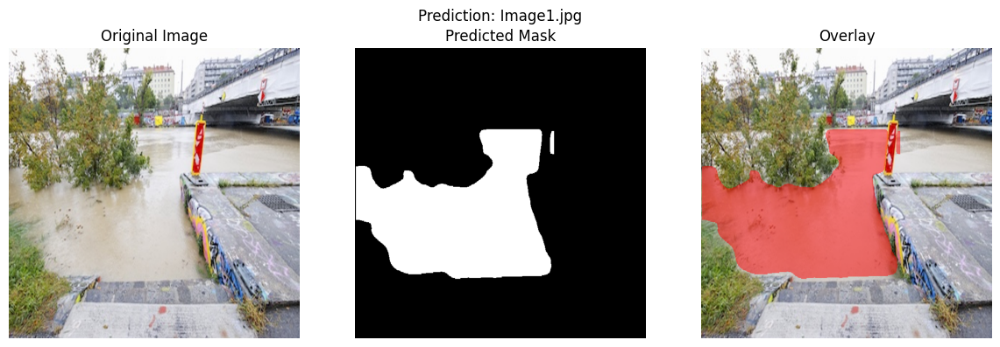

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image2.jpg: 544x640 2 floods, 59.4ms
Speed: 1.8ms preprocess, 59.4ms inference, 1.9ms postprocess per image at shape (1, 3, 544, 640)


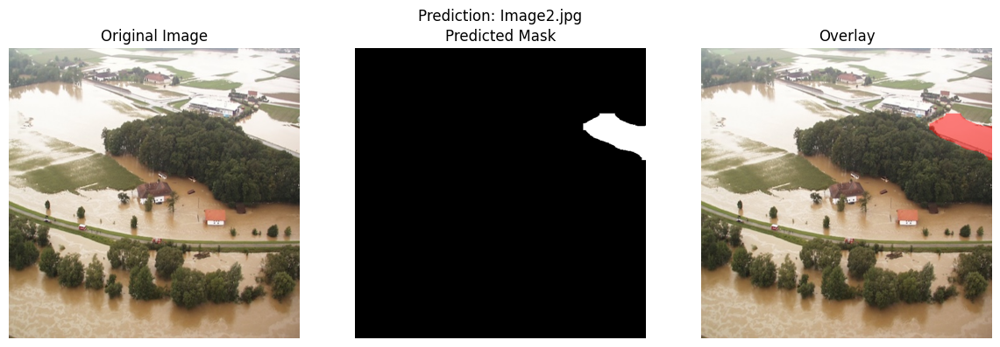

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image3.jpg: 448x640 1 flood, 9.2ms
Speed: 1.1ms preprocess, 9.2ms inference, 1.9ms postprocess per image at shape (1, 3, 448, 640)


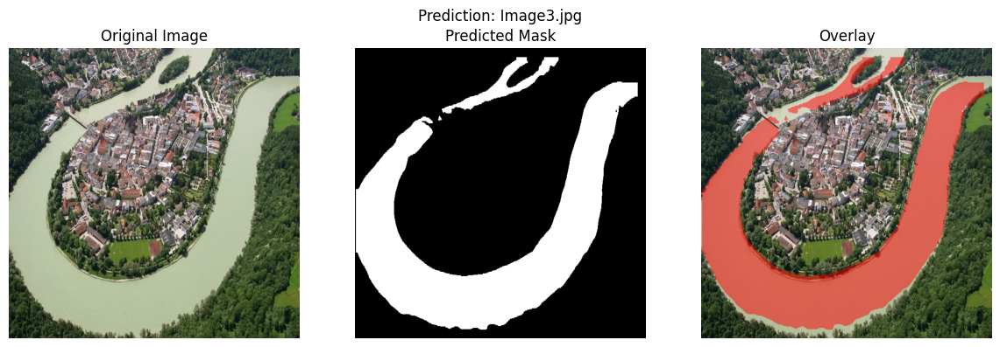

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image4.jpg: 384x640 2 floods, 9.9ms
Speed: 1.5ms preprocess, 9.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


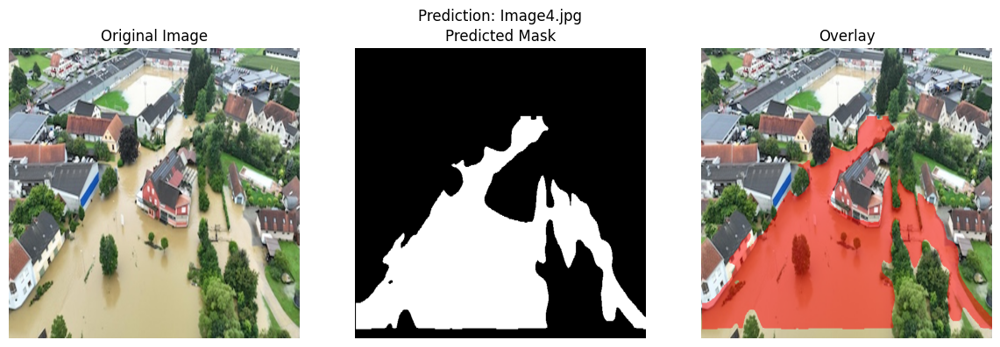

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image5.jpg: 640x544 1 flood, 57.8ms
Speed: 1.8ms preprocess, 57.8ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 544)


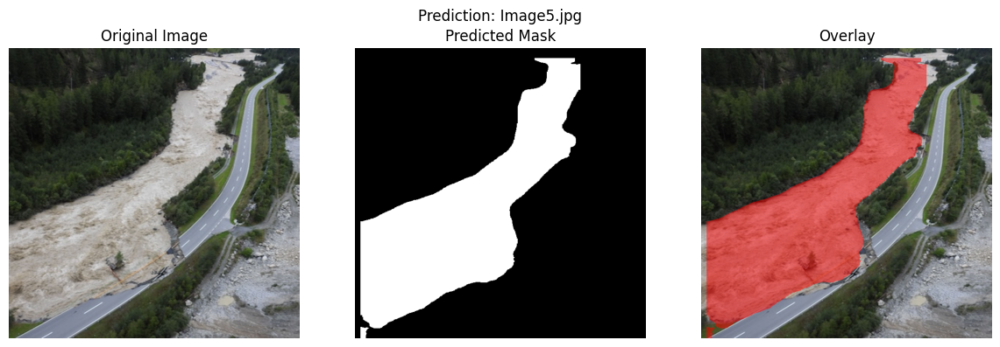

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image6.jpg: 384x640 1 flood, 9.1ms
Speed: 1.8ms preprocess, 9.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


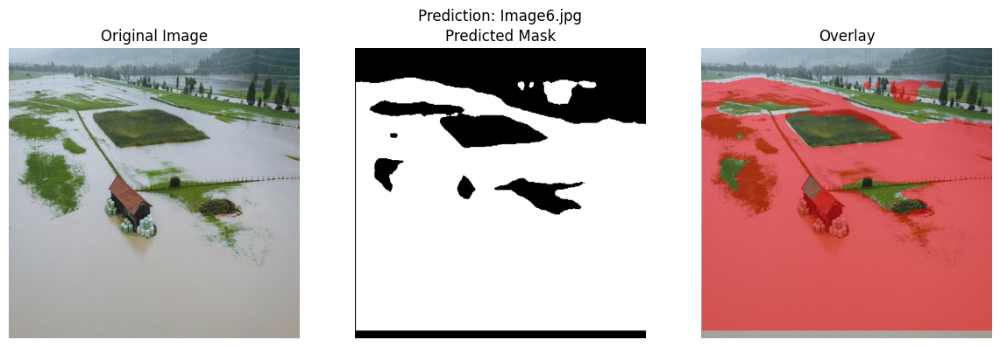

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image7.jpg: 480x640 2 floods, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


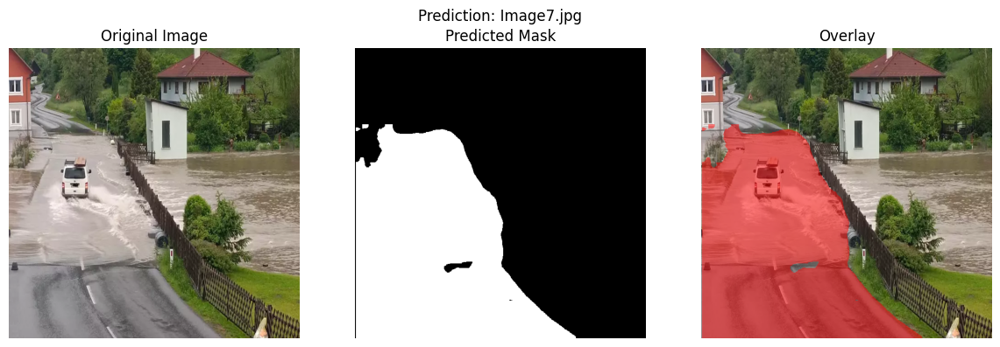

(640, 640, 3)

image 1/1 /mnt/nvme/home/aie3/christina/flood-area-segmentation/flood_images/Image8.jpg: 480x640 1 flood, 8.7ms
Speed: 2.0ms preprocess, 8.7ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


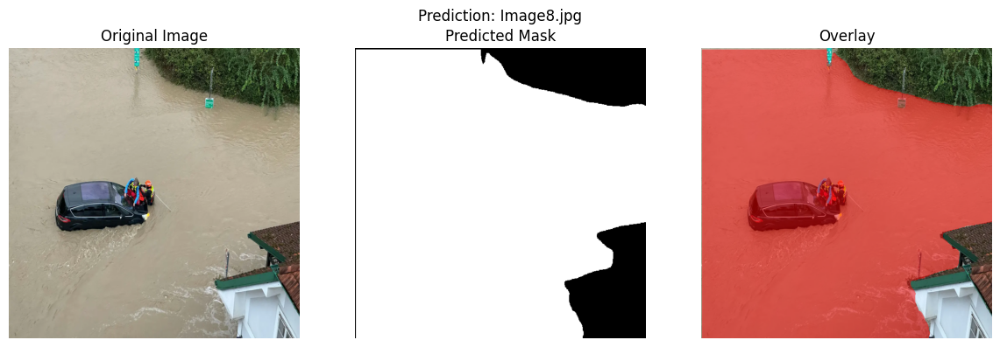

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from ultralytics import YOLO
from utils.visualize_prediction_yolo import visualize_prediction_yolo
import cv2

IMG_HEIGHT, IMG_WIDTH = 640, 640
IMAGE_FOLDER = 'flood_images'  
ALPHA = 0.5  # Transparency of the mask

# load the model
model = YOLO('./trained_models/yolo_dataAugmentation_model.pt')

# use images for predictions
image_files = sorted(os.listdir(IMAGE_FOLDER))
image_files = sorted(os.listdir(IMAGE_FOLDER))
for img_file in image_files:
    img_path = os.path.join(IMAGE_FOLDER, img_file)

    # Load image and scale to YOLO input size (YOLO also scales automatically internally)
    image = Image.open(img_path).convert("RGB") 
    image_resized = image.resize((IMG_WIDTH, IMG_HEIGHT))
    image_array = np.array(image_resized)
    print(image_array.shape)

    # YOLOv8 expects either path, array or tensor as input, here array as batch
    results = model.predict(source=img_path)

    pred_mask = results[0].masks.data.cpu().numpy()[0]
    pred_mask_resized = cv2.resize(pred_mask, (image_array.shape[1], image_array.shape[0]), interpolation=cv2.INTER_LINEAR)

    pred_binary = (pred_mask_resized > 0.5).astype(np.uint8)

    visualize_prediction_yolo(
        image_resized=image_array,
        pred_binary=pred_binary,
        img_file=img_file,
        alpha=ALPHA
    )


# TODO Yolo and U-NET

- [ ] in einem extra Dokument Ergebniss (Diagramme) vergleichen 
- [ ] Ergebnisse vergleichen und interpretieren (Text also Literatur) und verstehen - warum verwenden wir sie und was sagen sie aus? -> Diagramme 
- [ ] interesting finding dokumentieren (positv und negativ)
- [ ] pretrained Modell verstehen (YOLO-Analyse) ... zB KLasse (aus was besteht es und wie verwenden wir es) 
- [ ] Modellarchitekturen pro Modellversion und Methode (U-NET - YOLO)
- [ ] für Vergleich: Tabelle mit Hyperparametern und man sieht auf einen Blick die Ergebniss - Diagramme mehrere in einen Bild (auf schlüssige/eindeutige Beschriftung achten) - alles schön klar 
- [ ] Doku nur in jupyter NB ist ok - weiß nicht ob wir das machen wollen
- [ ] slides schon machen - wesentliche ERgebnisse 
- [ ] Tabelle machen (mit verschiedenen Hyperparametern und ERgebnissen Metriken ) - Diagramme (schlüssig bezeichnen nach Modellversion und )
- [ ] tensor - hyperparmater während modelltraining anpassen 

Verbesserungen am YOLO
- [ ] fine-tuning von yolo - freezing (sinnvoll) - mehr daten (data augmentation verwenden) usw.

Verbesserungen am U-Net
- [ ] Datenaugementation auch zb Verzehrung (elipsensförmig oder auch andere Möglichkeiten), drehen...
- [ ] Datenvorbereitung (Himmel wird schlecht erkannt) - hier zb noch Kontrast und schärfen 
- [ ] Hyperparameter early stopping, dropout (haben wir schon)
- [ ] learning rate anpassen - verwenden wir? 0.001 oder 0.0001 sind meist die besten
- [ ] anderen optimierer als Adam